## Data Science Case Study to Predict Malignant Tumor

#### Dataset: 

	The dataset copy of UCI ML Breast Cancer Wisconsin (Diagnostic) datasets. The Features are computed from a digitized image of a fine needle aspirate (FNA) of a breast mass.  They describe characteristics of the cell nuclei present in the image.


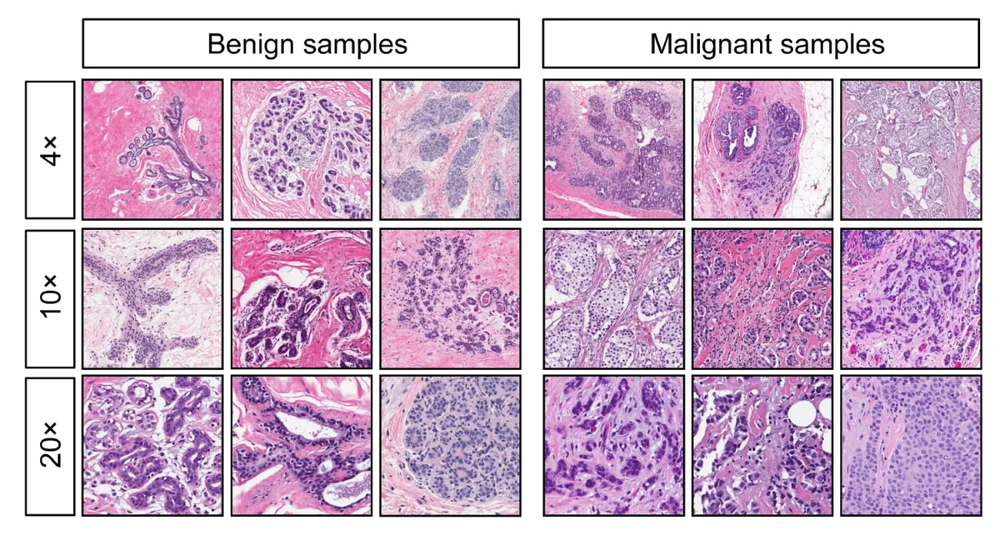

## Import required packages

In [140]:
import pandas as pd
import numpy as np
from scipy import stats
import warnings
warnings.filterwarnings("ignore")

import seaborn as sns
from matplotlib import pyplot as plt

from numpy import median, std, var
from scipy.stats import boxcox

from sklearn.model_selection import cross_val_score, KFold, train_test_split as tts, GridSearchCV, RandomizedSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression as lor
from sklearn.feature_selection import RFE, RFECV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.pipeline import Pipeline
from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc, precision_recall_curve

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler


pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width',None)

# `Importing the data`

In [2]:
from sklearn.datasets import load_breast_cancer

In [3]:
breast_data = load_breast_cancer()

In [4]:
print(breast_data.DESCR)

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

:Number of Instances: 569

:Number of Attributes: 30 numeric, predictive attributes and the class

:Attribute Information:
    - radius (mean of distances from center to points on the perimeter)
    - texture (standard deviation of gray-scale values)
    - perimeter
    - area
    - smoothness (local variation in radius lengths)
    - compactness (perimeter^2 / area - 1.0)
    - concavity (severity of concave portions of the contour)
    - concave points (number of concave portions of the contour)
    - symmetry
    - fractal dimension ("coastline approximation" - 1)

    The mean, standard error, and "worst" or largest (mean of the three
    worst/largest values) of these features were computed for each image,
    resulting in 30 features.  For instance, field 0 is Mean Radius, field
    10 is Radius SE, field 20 is Worst Radius.

    - 

In [5]:
print(breast_data.feature_names)

['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']


In [6]:
print(breast_data.target_names)

['malignant' 'benign']


# Q1: Write the code for below sub-questions



#### a. Print head of dataframe with proper column headers and target.

In [7]:
def convert_to_pandas_df(df):
    df_new = pd.DataFrame(df['data'], columns= df['feature_names'])
    df_new['target']=df['target']
    return df_new

In [8]:
print("The head of the data looks like:",'\n') 
breast_data_new = convert_to_pandas_df(breast_data)
breast_data_new.loc[:,'target'] = breast_data_new.target.map({0:1, 1:0})
breast_data_new.head()

The head of the data looks like: 



,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,1
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,1
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,1
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,1
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,1


#### b. Print shape of dataframe.

In [9]:
print("The shape of the data is:",'\n') 
breast_data_new.shape

The shape of the data is: 



(569, 31)

####  c. Print missing values in each column.

In [10]:
print("Number of missing values by Columns :",'\n\n','Method 1','\n\n',\
      breast_data_new.isnull().sum().reset_index().rename(columns={'index':'variables',0:'Number of missing records'}))

print('\n','Method 2','\n',\
      breast_data_new.isna().sum().reset_index().rename(columns={'index':'variables',0:'Number of missing records'}))

Number of missing values by Columns : 

 Method 1 

                   variables  Number of missing records
0               mean radius                          0
1              mean texture                          0
2            mean perimeter                          0
3                 mean area                          0
4           mean smoothness                          0
5          mean compactness                          0
6            mean concavity                          0
7       mean concave points                          0
8             mean symmetry                          0
9    mean fractal dimension                          0
10             radius error                          0
11            texture error                          0
12          perimeter error                          0
13               area error                          0
14         smoothness error                          0
15        compactness error                          0
16          

In [11]:
print('\n','Total number of missing records across coolumns :' , breast_data_new.isnull().any().sum())


 Total number of missing records across coolumns : 0


## 2. Summarise the data and call out insights in the data



##### a. Univariate Summarization

The plot below shows the distribution of data points across two types of tumor:


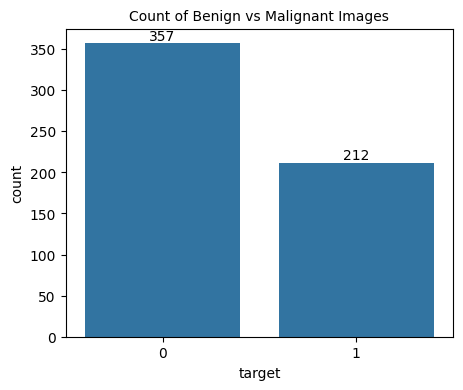

In [12]:
fig, ax = plt.subplots(1,1,figsize = (5,4))
ax = sns.countplot(x = breast_data_new['target'],data = breast_data_new)
ax.set_title('Count of Benign vs Malignant Images',fontsize=10)
ax.bar_label(ax.containers[0], label_type='edge')
print("The plot below shows the distribution of data points across two types of tumor:")
plt.show()

In [13]:
print("The dataset has", '{:.2f}'.format(212/569*100),'% of the observation as malignant and', '{:.2f}'.format(357/569*100), '% of the observation as benign')

The dataset has 37.26 % of the observation as malignant and 62.74 % of the observation as benign


### Also, the dataset is slightly imbalanced between the two groups with an approx. ratio of 60 : 40 between observations indicating Benign tumor compared against those with Malignant tumor. Therefore, while splitting the data into train an test set in the later part we will use stratified random sampling technique so that the proportion of the two classes in our target variable remains consistent across both the sets

` Let's deep dive into few basic statistics like range i.e. spread of the data, mean, median, mode, variance , skewness and distrbution of the data columns to get further understandng`

 The scatterplot for each of the variables show the spread of values or observations for each of the variables :


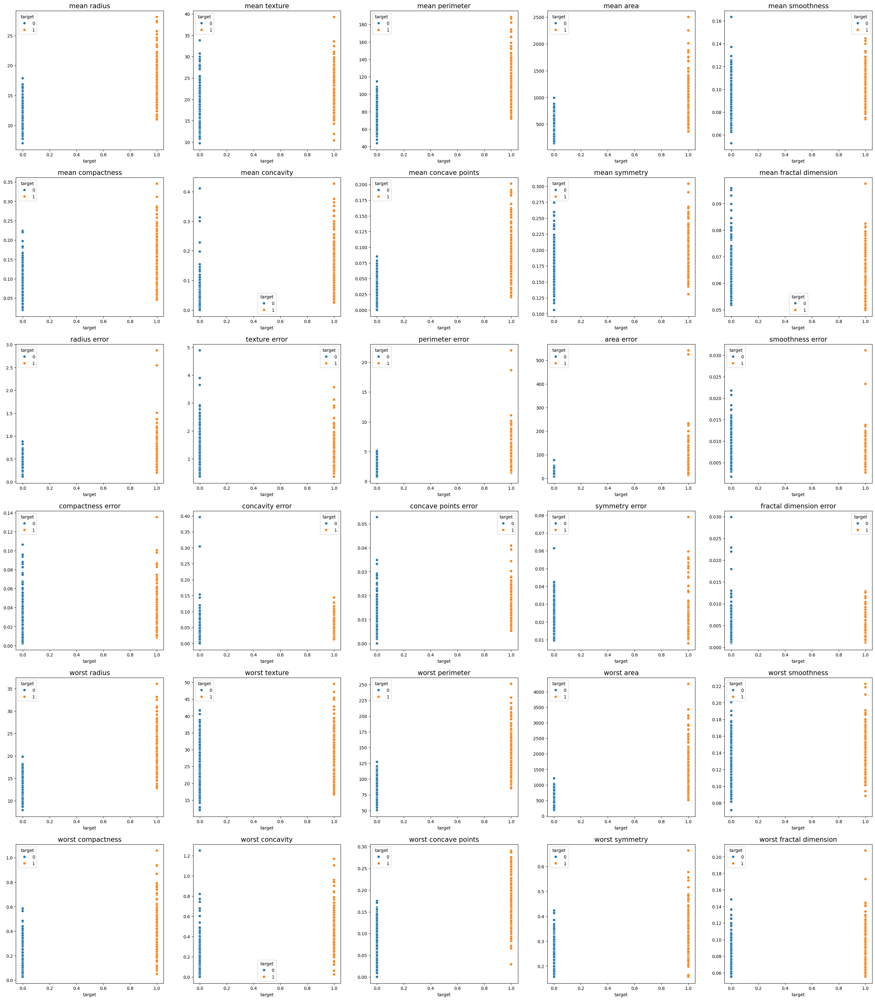

In [14]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)
print (" The scatterplot for each of the variables show the spread of values or observations for each of the variables :")
for ax, column in zip(axes,breast_data_new.columns):
    sns.scatterplot(breast_data_new,y=breast_data_new[column],x=breast_data_new['target'],hue=breast_data_new['target'],ax=ax)
    ax.set_title(column, fontsize=15)
    ax.set_ylabel(None)

In case of malignant tumors we see the observations for each of the variables **"mean radius", "mean perimeter", "mean area", "mean smoothness", "worst radius", "worst texture", "worst perimeter", "worst area" and "worst concave points"** are widely spread across in comparison to their benign counterparts with relatively higher value for the minima and maxima i.e. they relatively have a higher range

In the case of the variables **"mean fractal dimension", "texture error", "concave points error", "smoothness error" and "compactness error"** the observations from malignant tumors tend to have a less wider range as in they have less variation in values than their benign counterparts

### Plotting the mean of each of the variables by target variable

 The barplot for each of the variables show the difference in mean value for each of the variables while observed across both the categories for the target variable:




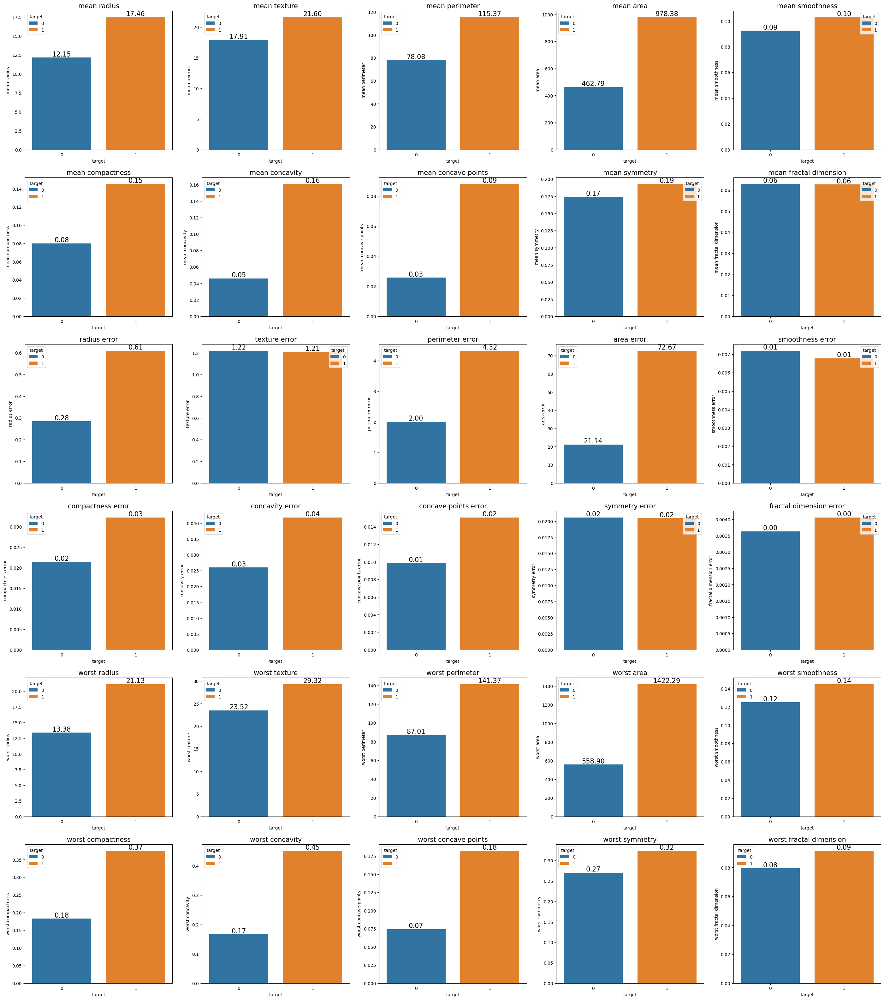

In [15]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)
print (" The barplot for each of the variables show the difference in mean value for each of the variables while observed across both the categories for the target variable:\n\n")
for ax, column in zip(axes,breast_data_new.columns):
    sns.barplot(data=breast_data_new, x=breast_data_new['target'], y= breast_data_new[column], hue=breast_data_new['target'], errorbar=None,ax=ax)
    ax.set_title(column, fontsize=15)
    for i in ax.containers:
        ax.bar_label(i,fmt='%.2f',fontsize=15)

**Note that** the mean value of each of the variables **"mean smoothness", "mean symmetry", "mean fractal dimension", "texture error", "smoothness error", "symmetry error", "fractal dimension error" and "worst fractal error"** does not differ significantly between the population of tumors which are malignant vs those which are benign. While for the rest the significant differences in the mean stand out to be list of probable variables to predict whether a certain tumor is malignant or benigh.

### Plotting the median of each of the variables by target variable

 The barplot for each of the variables show the difference in median value for each of the variables while observed across both the categories for the target variable:




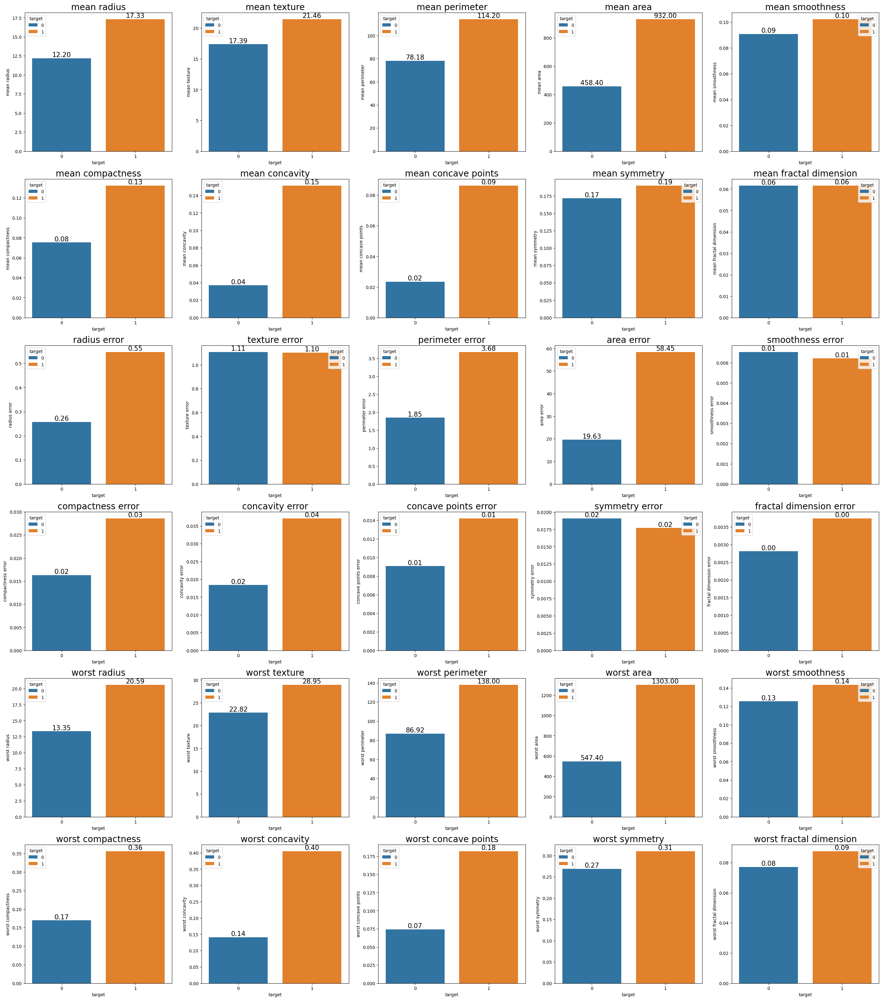

In [16]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)
print (" The barplot for each of the variables show the difference in median value for each of the variables while observed across both the categories for the target variable:\n\n")
for ax, column in zip(axes,breast_data_new.columns):
    sns.barplot(data=breast_data_new, x=breast_data_new['target'], y= breast_data_new[column], hue=breast_data_new['target'], estimator=np.median, errorbar=None,ax=ax)
    ax.set_title(column, fontsize=20)
    for i in ax.containers:
        ax.bar_label(i,fmt='%.2f',fontsize=15)

**The insights based on median values remain unchanged as we have already observed from the mean plots**

### Plotting the variance of each of the variables by target variable

 The barplot for each of the variables show the difference in the variance for each of the variables while observed across both the categories for the target variable:




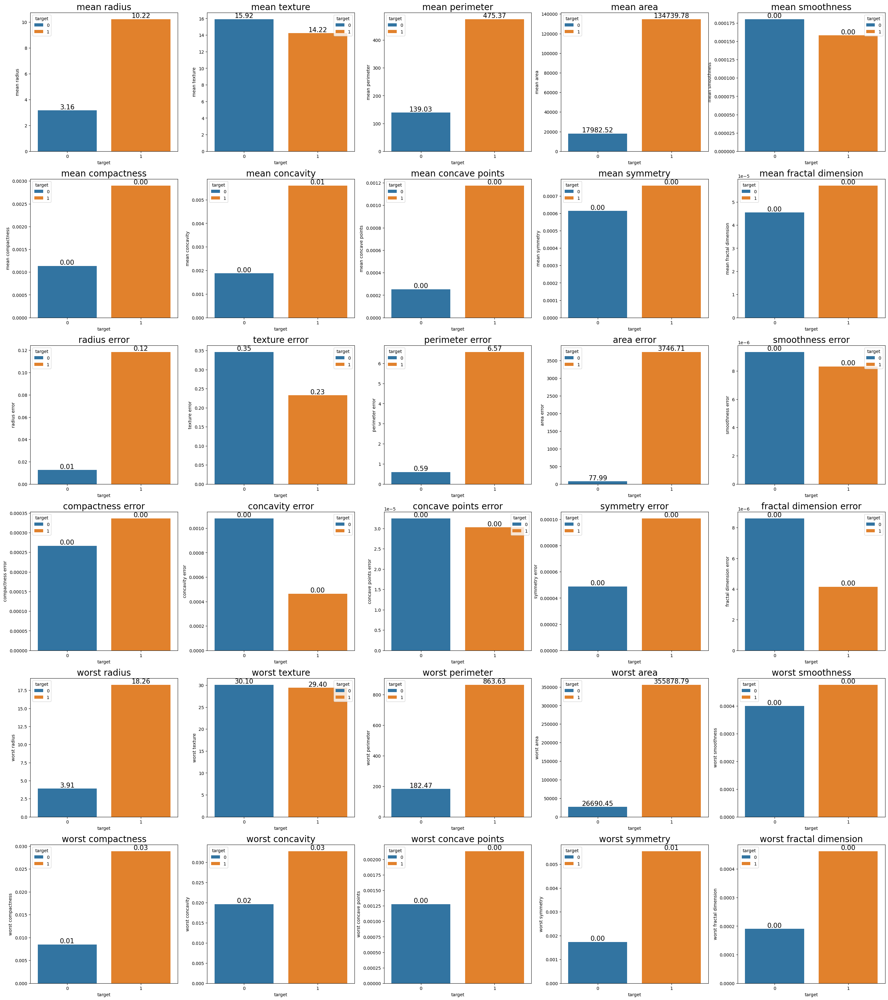

In [17]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)
print (" The barplot for each of the variables show the difference in the variance for each of the variables while observed across both the categories for the target variable:\n\n")
for ax, column in zip(axes,breast_data_new.columns):
    sns.barplot(data=breast_data_new, x=breast_data_new['target'], y= breast_data_new[column], hue=breast_data_new['target'], estimator = np.var, errorbar=None,ax=ax)
    ax.set_title(column, fontsize=20)
    for i in ax.containers:
        ax.bar_label(i,fmt='%.2f',fontsize=15)

**Conclusion :-**

For each of the variables , observations from malignant tumors have a lesser variance in comparison to their benign counterparts except for variables like **"texture error", "smoothness error", "fractal dimension error" and "concavity error"**

In [18]:
with sns.plotting_context(rc={"axes.labelsize":20}):
    sns.pairplot(breast_data_new, hue='target', corner=False)

#### From the plots above we see the variables : mean_texture, mean_smoothness, mean_symmetry, mean_concavity, mean symmetry, worst area, worst texture, worst smoothness, worst compactness are not so highly correlated with most of the features whereas the others seem to have high positive correlation with their counterparts. Further analysis will help us understand better.

From the plot above, it can be clearly observed that "worst radius", "worst perimeter", "worst concave points" and "mean radius" are few of the features which are not so correlated with other variables , at the same time showing how clearly they are able to distinguish between the two groups of tumor observations.

## Q3: Use any visualization/charts to show distribution of all the columns and target in the data. Call out specific Insights.

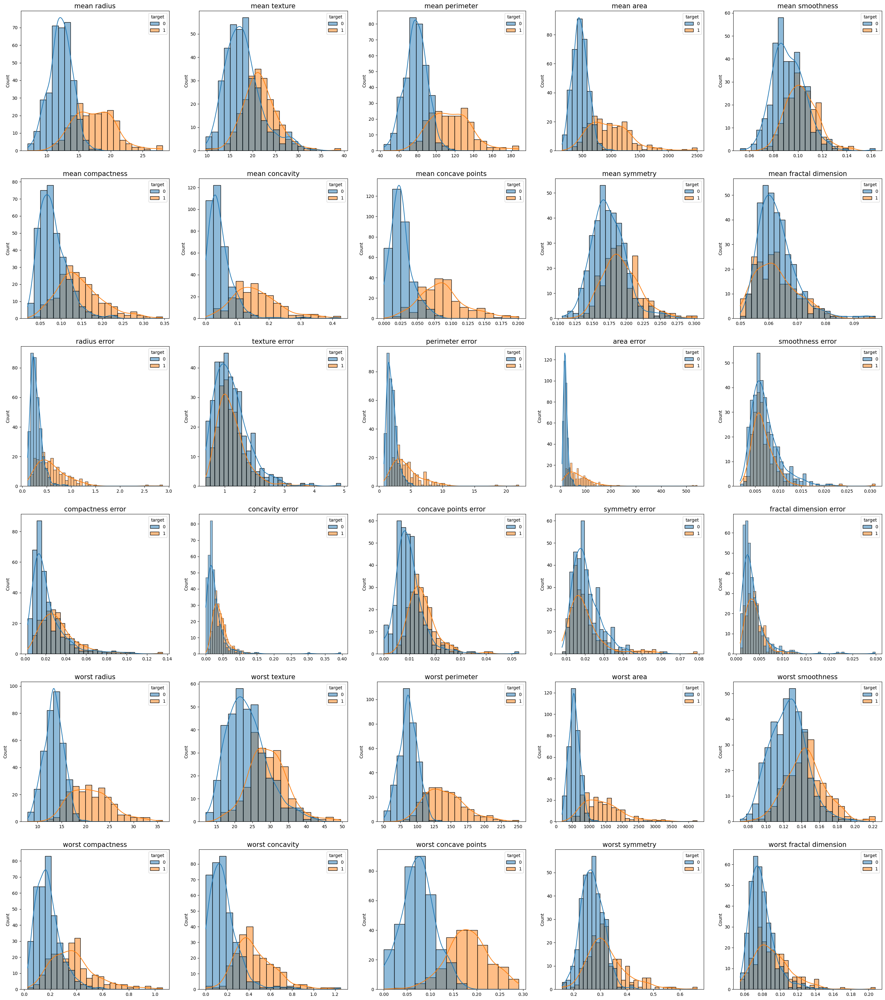

In [19]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)

for ax, column in zip(axes,breast_data_new.columns):
    sns.histplot(breast_data_new,x=breast_data_new[column],kde=True,hue='target',ax=ax)
    ax.set_title(column, fontsize=15)
    ax.set_xlabel(None)

Variables such as **"mean texture", "mean smoothness", "mean symmetry", "mean fractal dimension", "worst texture", "worst smoothness", "texture error", "worst symmetry"** and **"worst fractal dimension"** have a **similarity in distribution** across both types of tumors implying that they might not make the best choice in variable selection while trying to predict whether a certain type of tumor is malignant or benign. 

On the other hand, we do observe that for variables like **"mean radius", "mean perimeter", "mean area", "mean concavity", "worst radius", "worst perimeter", "worst concave points"** the distribution of the data with malignant tumors are positively skewed i.e. the mean of the distribution of each of the variables for benign tumor is inclined towards lower values where as in case of malignant tumors data points are seen to be symmetrically distributed for these variables. This imply that these variables mght make a good choice in predicting whether a certain type of tumor is malignant or benign.  

Another call out is variables like **"radius error", "perimeter error", "area error", "concavity error" and "fractal dimension error"** are seen to be highly skewed which imply that these variables if used directly to make any prediction related to whether a tumor is malignant or benign, results will be biased towards typical observations and not take into account the non-typical ones thus impacting end result. Therefore , these variables need to be transformed to symmetric distribution which then will be unbiased towards prediction.

#### `Boxplot diagram in the original data`

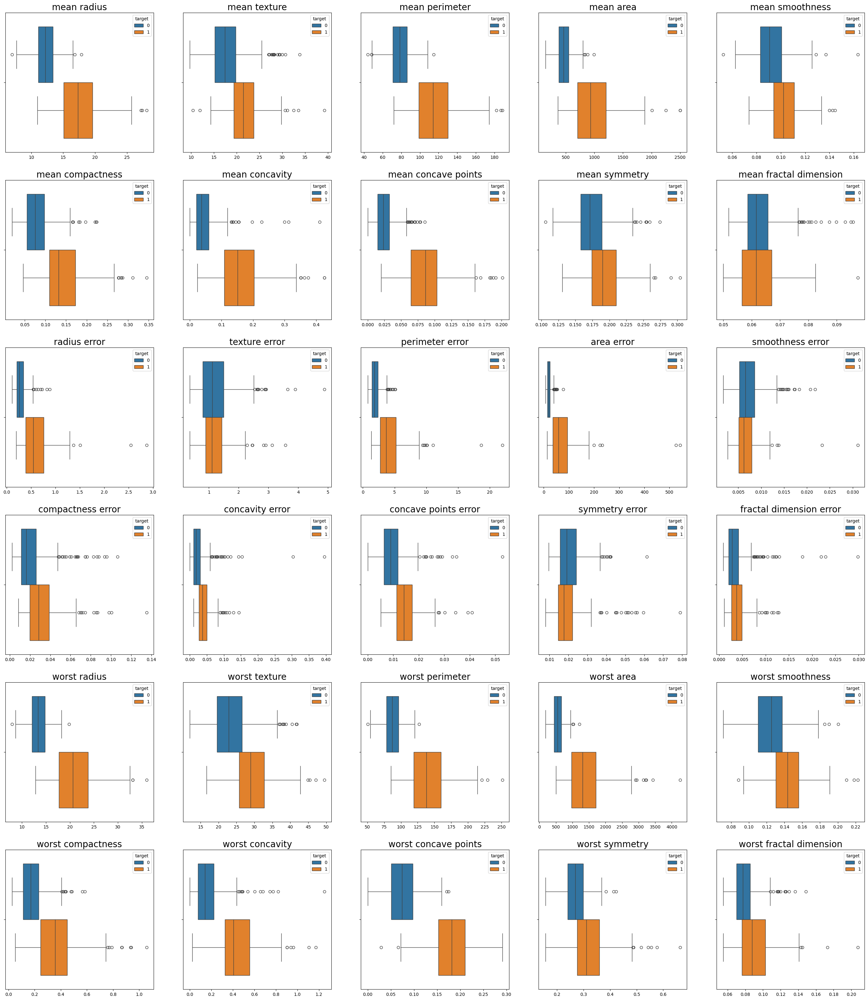

In [20]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)

for ax, column in zip(axes,breast_data_new.columns):
    sns.boxplot(breast_data_new,x=breast_data_new[column],hue='target',ax=ax)
    ax.set_title(column,fontsize=20)
    ax.set_xlabel(None)

**Insights from Boxplot :**

The boxplot diagram above shows that distribution of the variables **"mean compactness", "mean concavity", "mean concave points"** significantly differ between the population with malignant tumor (target = 1) vs population with benign tumor (target = 0). Also, it is clearly observed that for majority of the variables under the "Benign" class a lot of outliers are present above upper interquartile range value . This implies that the distributions in most cases is highly skewed to the right.

## Q4. Can you compute 10, 25, 50, 75, 90, 99 percentiles for all the columns?

In [21]:
print(" Below we can see the respective percentiles for all the columns :\n\n")
breast_data_new.drop('target',axis=1).describe(percentiles = [0.1, 0.25, 0.5, 0.75, 0.9, 0.99])[4:-1].T

 Below we can see the respective percentiles for all the columns :




,10%,25%,50%,75%,90%,99%
mean radius,10.260000,11.700000,13.370000,15.780000,19.530000,24.371600
mean texture,14.078000,16.170000,18.840000,21.800000,24.992000,30.652000
mean perimeter,65.830000,75.170000,86.240000,104.100000,129.100000,165.724000
mean area,321.600000,420.300000,551.100000,782.700000,1177.400000,1786.600000
mean smoothness,0.079654,0.086370,0.095870,0.105300,0.114820,0.132888
mean compactness,0.049700,0.064920,0.092630,0.130400,0.175460,0.277192
mean concavity,0.013686,0.029560,0.061540,0.130700,0.203040,0.351688
mean concave points,0.011158,0.020310,0.033500,0.074000,0.100420,0.164208
mean symmetry,0.149580,0.161900,0.179200,0.195700,0.214940,0.259564
mean fractal dimension,0.055338,0.057700,0.061540,0.066120,0.072266,0.085438


## Q5: Are there any outliers in the data? Can you use at least 2 ways to find the outlier?

#### In the prior charts/visualizations above we have called out certain features in particular which are observed to be highly skewed in nature. To detect outliers for those variables we will do log transformation to reduce skewness
  
  a. One of the ways to detect will be using z-scores where in any value outside -3 and +3 is ideally called as an outlier. Assumption behind using a 
     z-score to detect whether a variable has outliers or not will be to first understand whether the distributions for each of those follow a normal        distribution
  
  b. Another way to detect outliers in the data will be to first apply some transformation on the highly skewed variables to reduce skewness and             then observe for outliers through boxplot such that if any observation picked at random from the population group is outside the Interquartile          Range then they are said to be outliers. Since most of the variables are right-skewed in nature, a log transformation is something we will do here.

  c. Any observation beyond the 99th percentile and below 1 percentile is also considered as outliers

**Let us try out each of these three methods one by one**

`a. One of the ways to detect will be using z-scores where in any value outside -3 and +3 is ideally called as an outlier. Assumption behind using a z-score to detect whether a variable has outliers or not will be to first understand whether the distributions for each of those follow a normal distribution`

### a. What is a Q-Q Plot?

A Q-Q (Quantile-Quantile) plot is used to see if a dataset follows a particular theoretical distribution. It works by comparing the quantiles of the observed data to the quantiles of this other distribution. A specific type of Q-Q plot is called Q-Q Norm plot where observed values are plotted against the ‘theoretical quantiles’ assuming the underlying distribution to be the normal distribution.

To construct a normal Q-Q plot, the are the steps we need to follow :-
   a. First rank the array of numbers considered in ascending order with the rank i assigned to the i(th) observation in the ordered array
   b. Calculate the probability with this equation: q = (i– 0.5)/n 
   c. Then, we could use the percent-point function (PPF) of the standard normal distribution (the qnorm() function) to find the corresponding value          for the rank. (Unlike cumulative distribution function (CDF), which tells us the probability up to a value x, the PPF is like the opposite: It          gives us the x-value for a given probability.) 

Finally, to create the graph, we plot the quantiles of our observed values against the theoretical quantiles (hence the two Qs in Q-Q plot). The line is constructed by calculating the slope and intercept using the first and third quartiles of both the observed and theoretical distributions.

#### QQ Norm Plots - Malignant Tumor Class

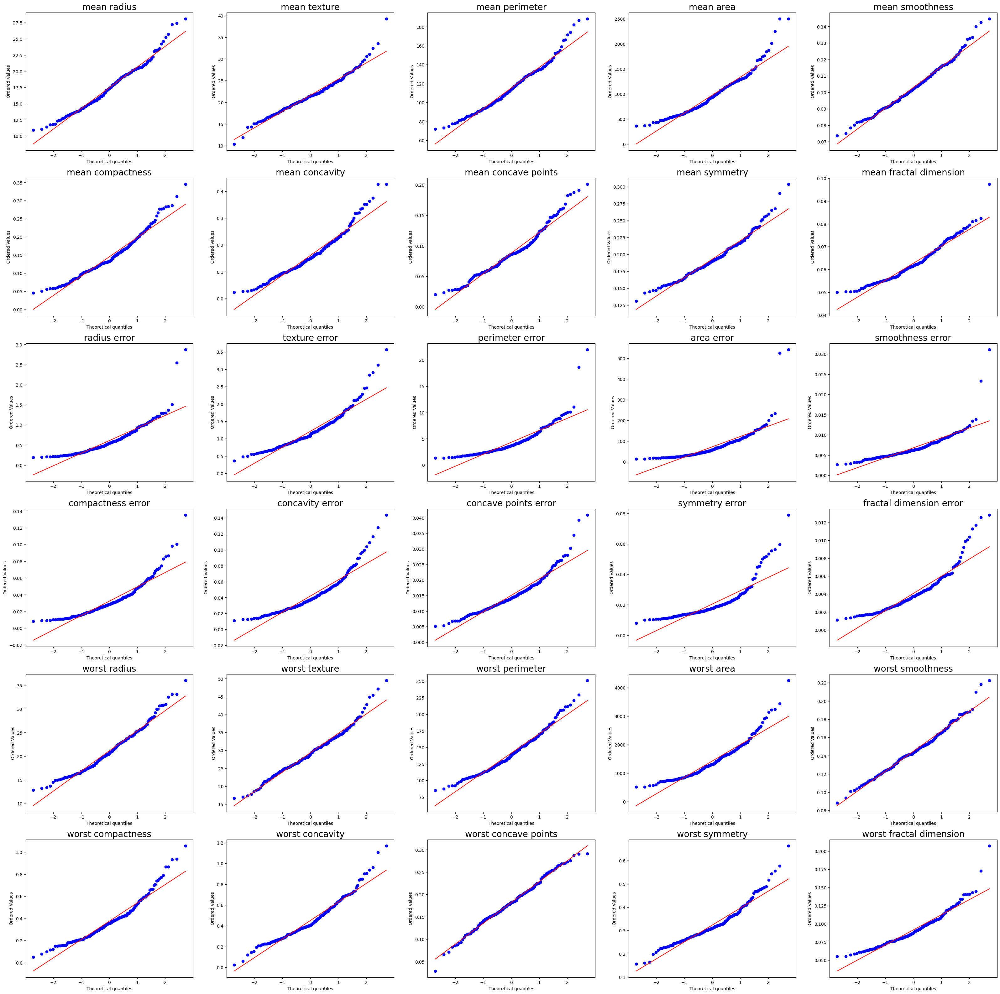

In [22]:
fig, axes = plt.subplots(6,5)

fig.set_size_inches(40,40)

for ax, col  in zip(axes.ravel(),breast_data_new):
    stats.probplot(breast_data_new[breast_data_new.target==1][col], dist = "norm", plot = ax)
    ax.set_title(col, fontsize=20)

**Conclusion** The above plots represent the fact whether each of the variables under study follow a normal distribution.If the data points have a near to perfect distribution along the red line below which is the theoretical quantiles of the normal distribtution,then we say the variable has a distribution similar to normal distribution else not.

#### QQ Norm Plots - Benign Tumor Class

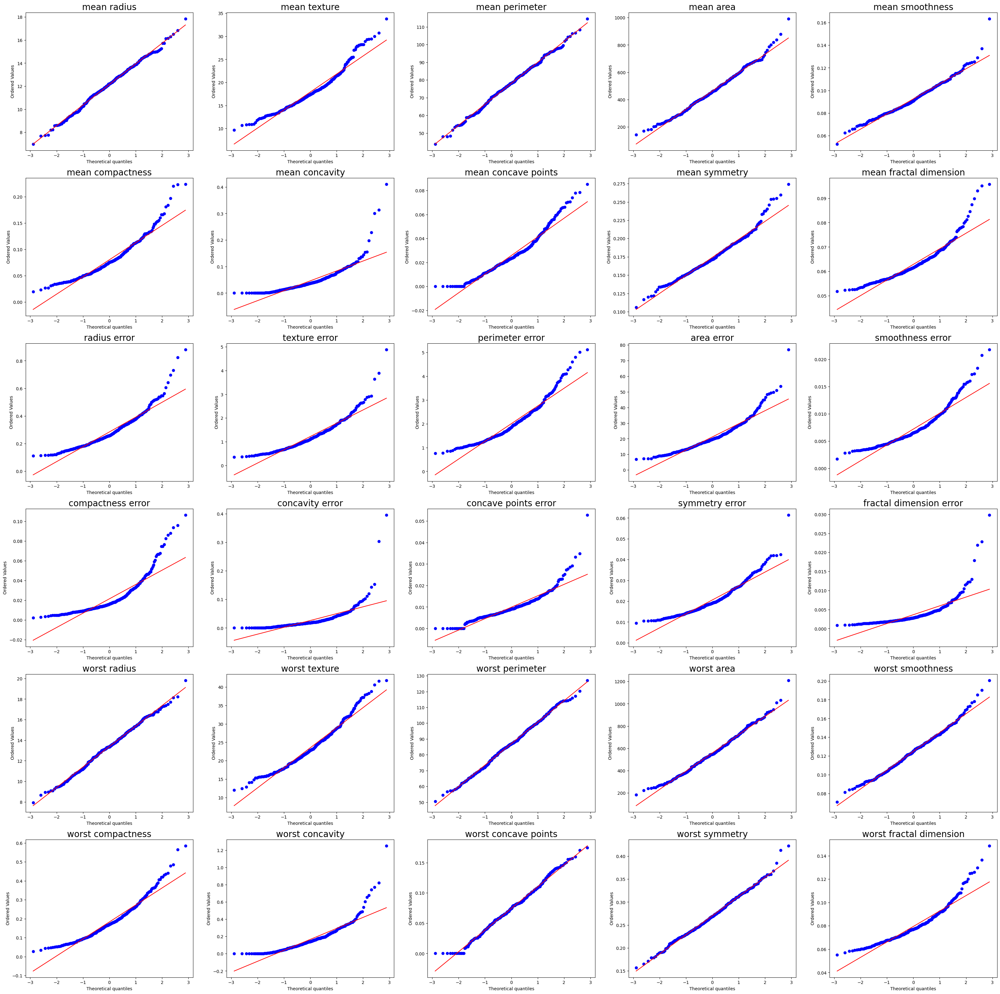

In [23]:
fig, axes = plt.subplots(6,5)

fig.set_size_inches(40,40)

for ax, col  in zip(axes.ravel(),breast_data_new):
    stats.probplot(breast_data_new[breast_data_new.target==0][col], dist = "norm", plot = ax)
    ax.set_title(col, fontsize=20)

### Shapiro Wilks Test to check Normality :

H0 : The underlying data is Normally distributed

H1 : The underlying data is not Normally distributed

In [24]:
shapiro_df = pd.DataFrame()
col_names, malignant_pvals, benign_pvals = [] , [] , []


for col in breast_data_new.columns[:-1]:  
    col_name = col 
    malignant_pval , benign_pval = float(format(stats.shapiro(breast_data_new[breast_data_new.target==1][col]).pvalue,'.4f')) , float(format(stats.shapiro(breast_data_new[breast_data_new.target==0][col]).pvalue,'.4f'))
    col_names.append(col_name), malignant_pvals.append(malignant_pval), benign_pvals.append(benign_pval)
    

shapiro_df = pd.DataFrame({'variable':col_names,'Target = 1 i.e. Malignant': malignant_pvals, 'Target = 0 i.e. Benign' :benign_pvals})
shapiro_df['verdict_malignant'] = shapiro_df.apply(lambda x : 'distribution is not normal' if x['Target = 1 i.e. Malignant'] < 0.05  else 'distribution is normal', axis=1)
shapiro_df['verdict_benign'] = shapiro_df.apply(lambda x : 'distribution is not normal' if x['Target = 0 i.e. Benign'] < 0.05  else 'distribution is normal', axis=1)

## To decide on whether z-scores will make a good choice to find outliers in the data

shapiro_df['decision_zscores_outliers'] = shapiro_df.apply(lambda x : 'Yes' if ((x['verdict_malignant']=='distribution is normal') & (x['verdict_benign']=='distribution is normal')) else 'No', axis=1)
shapiro_df[shapiro_df.decision_zscores_outliers=='Yes']

,variable,Target = 1 i.e. Malignant,Target = 0 i.e. Benign,verdict_malignant,verdict_benign,decision_zscores_outliers


**Conclusion :**

In all of the above cases , we see that in case of all the variables , the distribution under both the classes simultaneously never follow a Normal distribution and hence we cannot use z-scores to detect outliers as for that distributions need to be symmetric, although log transformation led to some symmetricity in distributions for the assymetric ones. Hence, we will detect outliers in the data based on the other two methods.

`b. Another way to detect outliers in the data will be to first apply some transformation on the highly skewed variables to reduce skewness and then observe for outliers through boxplot such that if any observation picked at random from the population group is outside the Interquartile Range then they are said to be outliers. Since most of the variables are right-skewed in nature, a log transformation is something we will do here.`

**Let's first try to understand the highly skewed variables and accordingly we will apply log transformation as next steps only for those variables**

Skewed data will degrade some of our model's ability to describe more "typical" cases in order to deal with much rarer cases which happen to take extreme values.

### Pearson's Second Coefficient (Skewness measure):


Pearson's Second Coefficient = 3 * (Mean - Median) / Standard Deviation

If this value is between :

1. -0.5 and 0.5 , the distribution is almost symmetrical
2. -1 and -0.5, the data is negatively skewed, and if it is between 0.5 to 1 , the data is positively skewed. The skewness is moderate.
3. If the skewness is lower than -1 (negatively skewed) or greater than 1 (positively skewed), the data is highly skewed

#### `Let us try to come up with a measure of skewness which we will use as a baseline to detect skewness in certain features and will transform them using suitable transformation`

In [25]:
skewness_check_df = pd.DataFrame()
col_names, skewness_vals = [] , []


for col in breast_data_new.columns[:-1]:  
    col_name = col 
    skewness_val = 3*(breast_data_new[col].mean() - breast_data_new[col].median())/breast_data_new[col].std()
    col_names.append(col_name), skewness_vals.append(skewness_val)
    

skewness_check_df = pd.DataFrame({'variable':col_names,'skewness': skewness_vals})
skewness_check_df['skewness_category'] = skewness_check_df.apply(lambda x : 'almost symmetrical' if (x['skewness'] >= -0.5 and x['skewness']< 0.5) \
                        else 'moderately skewed' if ((x['skewness'] >= -1 and x['skewness'] < -0.5) or (x['skewness'] >= 0.5 and x['skewness'] < 1)) \
                        else 'highly skewed' if (x['skewness']<=-1 or x['skewness']>=1) \
                        else 'symmetric', axis=1)

## To decide on which of these variables require a transformation to reduce skewness
skewness_check_df['skewness_type'] = skewness_check_df.apply(lambda x: 'positively skewed' if x['skewness']>0 else 'negatively skewed',axis=1)
skewness_check_df['decision_treat_skewness'] = skewness_check_df.apply(lambda x : 'Yes' if ((x['skewness_category']=='moderately skewed') or (x['skewness_category']=='highly skewed')) else 'No', axis=1)
skewness_check_df[skewness_check_df.decision_treat_skewness=='Yes']

,variable,skewness,skewness_category,skewness_type,decision_treat_skewness
0,mean radius,0.644678,moderately skewed,positively skewed,Yes
2,mean perimeter,0.707318,moderately skewed,positively skewed,Yes
3,mean area,0.884782,moderately skewed,positively skewed,Yes
5,mean compactness,0.665236,moderately skewed,positively skewed,Yes
6,mean concavity,1.025817,highly skewed,positively skewed,Yes
7,mean concave points,1.192115,highly skewed,positively skewed,Yes
9,mean fractal dimension,0.534368,moderately skewed,positively skewed,Yes
10,radius error,0.875965,moderately skewed,positively skewed,Yes
11,texture error,0.591972,moderately skewed,positively skewed,Yes
12,perimeter error,0.859200,moderately skewed,positively skewed,Yes


### Let's create a new dataframe where we will store the other variables along with log-transformed variables and we will use this dataframe to detect and treat outliers in the data

#### `Log Transformation` is well suited for right skewed ditributions

In [26]:
breast_data_transformed = pd.DataFrame()

breast_data_transformed = \
breast_data_new[[i for i in breast_data_new.columns if i in list(skewness_check_df[skewness_check_df.decision_treat_skewness=='Yes'].variable.unique())]]

breast_data_transformed.head()

,mean radius,mean perimeter,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension
0,17.99,122.80,1001.0,0.27760,0.3001,0.14710,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.03003,0.006193,25.38,184.60,2019.0,0.6656,0.7119,0.2654,0.11890
1,20.57,132.90,1326.0,0.07864,0.0869,0.07017,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01389,0.003532,24.99,158.80,1956.0,0.1866,0.2416,0.1860,0.08902
2,19.69,130.00,1203.0,0.15990,0.1974,0.12790,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02250,0.004571,23.57,152.50,1709.0,0.4245,0.4504,0.2430,0.08758
3,11.42,77.58,386.1,0.28390,0.2414,0.10520,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.05963,0.009208,14.91,98.87,567.7,0.8663,0.6869,0.2575,0.17300
4,20.29,135.10,1297.0,0.13280,0.1980,0.10430,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01756,0.005115,22.54,152.20,1575.0,0.2050,0.4000,0.1625,0.07678


In [27]:
for col in breast_data_transformed :
    breast_data_transformed[col] = breast_data_transformed[col].apply(lambda x : np.log(x + 0.52))

breast_data_transformed.head()

,mean radius,mean perimeter,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension
0,2.918311,4.814783,6.909274,-0.226148,-0.198329,-0.404815,-0.512978,0.479335,0.354382,2.209263,5.036433,-0.641696,-0.563805,-0.555596,-0.597782,-0.642087,3.254243,5.221004,7.610615,0.170249,0.208558,-0.241562,-0.448007
1,3.048799,4.893502,7.190314,-0.513095,-0.499391,-0.527345,-0.550485,0.061565,0.226259,1.365581,4.312141,-0.643929,-0.629084,-0.618782,-0.627565,-0.647157,3.239071,5.070915,7.578923,-0.347291,-0.272334,-0.348140,-0.495904
2,3.006178,4.871526,7.093006,-0.385810,-0.332122,-0.434019,-0.544744,0.235546,0.267658,1.630220,4.549129,-0.642169,-0.579711,-0.582823,-0.611567,-0.645174,3.181797,5.030569,7.443968,-0.057100,-0.030047,-0.270497,-0.498271
3,2.479894,4.357990,5.957442,-0.218280,-0.272596,-0.469684,-0.482173,0.015480,0.516410,1.377506,3.323236,-0.636559,-0.519900,-0.550589,-0.545365,-0.636374,2.736314,4.599052,6.342509,0.326638,0.188055,-0.251672,-0.366725
4,3.035434,4.909857,7.168210,-0.426484,-0.331286,-0.471124,-0.546746,0.244670,0.263364,1.784735,4.553456,-0.632071,-0.607685,-0.550121,-0.620715,-0.644138,3.138100,5.028606,7.362341,-0.321584,-0.083382,-0.381993,-0.516207


##### Checking for any missinhg value in the transformed data

In [28]:
pd.DataFrame(breast_data_transformed.isna().sum()).T

,mean radius,mean perimeter,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [29]:
breast_data_not_transformed = \
breast_data_new[[i for i in breast_data_new.columns if i not in list(skewness_check_df[skewness_check_df.decision_treat_skewness=='Yes'].variable.unique())]]

## The transformed data is now ready to perform outlier checks

In [30]:
breast_data_transformed = breast_data_transformed.merge(breast_data_not_transformed, left_index=True, right_index=True)
breast_data_transformed.head()

,mean radius,mean perimeter,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension,mean texture,mean smoothness,mean symmetry,concave points error,worst texture,worst smoothness,worst symmetry,target
0,2.918311,4.814783,6.909274,-0.226148,-0.198329,-0.404815,-0.512978,0.479335,0.354382,2.209263,5.036433,-0.641696,-0.563805,-0.555596,-0.597782,-0.642087,3.254243,5.221004,7.610615,0.170249,0.208558,-0.241562,-0.448007,10.38,0.11840,0.2419,0.01587,17.33,0.1622,0.4601,1
1,3.048799,4.893502,7.190314,-0.513095,-0.499391,-0.527345,-0.550485,0.061565,0.226259,1.365581,4.312141,-0.643929,-0.629084,-0.618782,-0.627565,-0.647157,3.239071,5.070915,7.578923,-0.347291,-0.272334,-0.348140,-0.495904,17.77,0.08474,0.1812,0.01340,23.41,0.1238,0.2750,1
2,3.006178,4.871526,7.093006,-0.385810,-0.332122,-0.434019,-0.544744,0.235546,0.267658,1.630220,4.549129,-0.642169,-0.579711,-0.582823,-0.611567,-0.645174,3.181797,5.030569,7.443968,-0.057100,-0.030047,-0.270497,-0.498271,21.25,0.10960,0.2069,0.02058,25.53,0.1444,0.3613,1
3,2.479894,4.357990,5.957442,-0.218280,-0.272596,-0.469684,-0.482173,0.015480,0.516410,1.377506,3.323236,-0.636559,-0.519900,-0.550589,-0.545365,-0.636374,2.736314,4.599052,6.342509,0.326638,0.188055,-0.251672,-0.366725,20.38,0.14250,0.2597,0.01867,26.50,0.2098,0.6638,1
4,3.035434,4.909857,7.168210,-0.426484,-0.331286,-0.471124,-0.546746,0.244670,0.263364,1.784735,4.553456,-0.632071,-0.607685,-0.550121,-0.620715,-0.644138,3.138100,5.028606,7.362341,-0.321584,-0.083382,-0.381993,-0.516207,14.34,0.10030,0.1809,0.01885,16.67,0.1374,0.2364,1


#### Let's plot the histogram charts and check if the skewness has reduced for certain variables

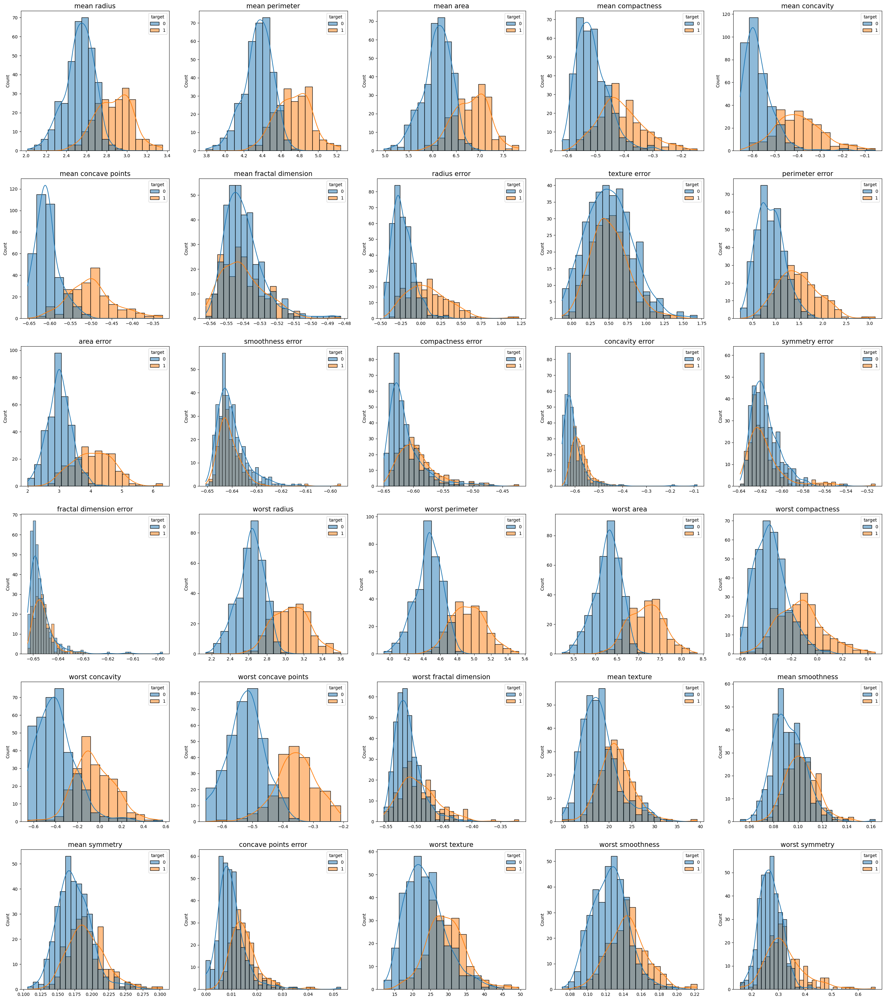

In [31]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)

for ax, column in zip(axes,breast_data_transformed.columns):
    sns.histplot(breast_data_transformed,x=breast_data_transformed[column],kde=True,hue='target',ax=ax)
    ax.set_title(column, fontsize=15)
    ax.set_xlabel(None)

In [32]:
skewness_check_df_logt = pd.DataFrame()
col_names, skewness_vals = [] , []


for col in breast_data_transformed.columns[:-1]:  
    col_name = col 
    skewness_val = 3*(breast_data_transformed[col].mean() - breast_data_transformed[col].median())/breast_data_transformed[col].std()
    col_names.append(col_name), skewness_vals.append(skewness_val)
    

skewness_check_df_logt = pd.DataFrame({'variable':col_names,'skewness': skewness_vals})
skewness_check_df_logt['skewness_category'] = skewness_check_df_logt.apply(lambda x : 'almost symmetrical' if (x['skewness'] >= -0.5 and x['skewness']< 0.5) \
                        else 'moderately skewed' if ((x['skewness'] >= -1 and x['skewness'] < -0.5) or (x['skewness'] >= 0.5 and x['skewness'] < 1)) \
                        else 'highly skewed' if (x['skewness']<=-1 or x['skewness']>=1) \
                        else 'symmetric', axis=1)

## To decide on which of these variables require a transformation to reduce skewness
skewness_check_df_logt['skewness_type'] = skewness_check_df_logt.apply(lambda x: 'positively skewed' if x['skewness']>0 else 'negatively skewed',axis=1)
skewness_check_df_logt['decision_treat_skewness'] = skewness_check_df_logt.apply(lambda x : 'Yes' if ((x['skewness_category']=='moderately skewed') or (x['skewness_category']=='highly skewed')) else 'No', axis=1)
skewness_check_df_logt[skewness_check_df_logt.decision_treat_skewness=='Yes']

,variable,skewness,skewness_category,skewness_type,decision_treat_skewness
3,mean compactness,0.574072,moderately skewed,positively skewed,Yes
4,mean concavity,0.932700,moderately skewed,positively skewed,Yes
5,mean concave points,1.149448,highly skewed,positively skewed,Yes
6,mean fractal dimension,0.520912,moderately skewed,positively skewed,Yes
7,radius error,0.723659,moderately skewed,positively skewed,Yes
10,area error,0.756888,moderately skewed,positively skewed,Yes
11,smoothness error,0.656585,moderately skewed,positively skewed,Yes
12,compactness error,0.822010,moderately skewed,positively skewed,Yes
13,concavity error,0.586737,moderately skewed,positively skewed,Yes
14,symmetry error,0.646616,moderately skewed,positively skewed,Yes


**Conclusion**

As we can see that after the square root transformation we have been able to reduce the number of comes highly skewed to 1 and most of the features we see above have a skewness between 0.5 to 0.9. Therefore , the transformed data is now ready to be tested for outlier detection

#### `Plotting each of the variables for Target population with tumor group as Malignant and checking whether the distribution for most of them comes out to be Normal distribution.`

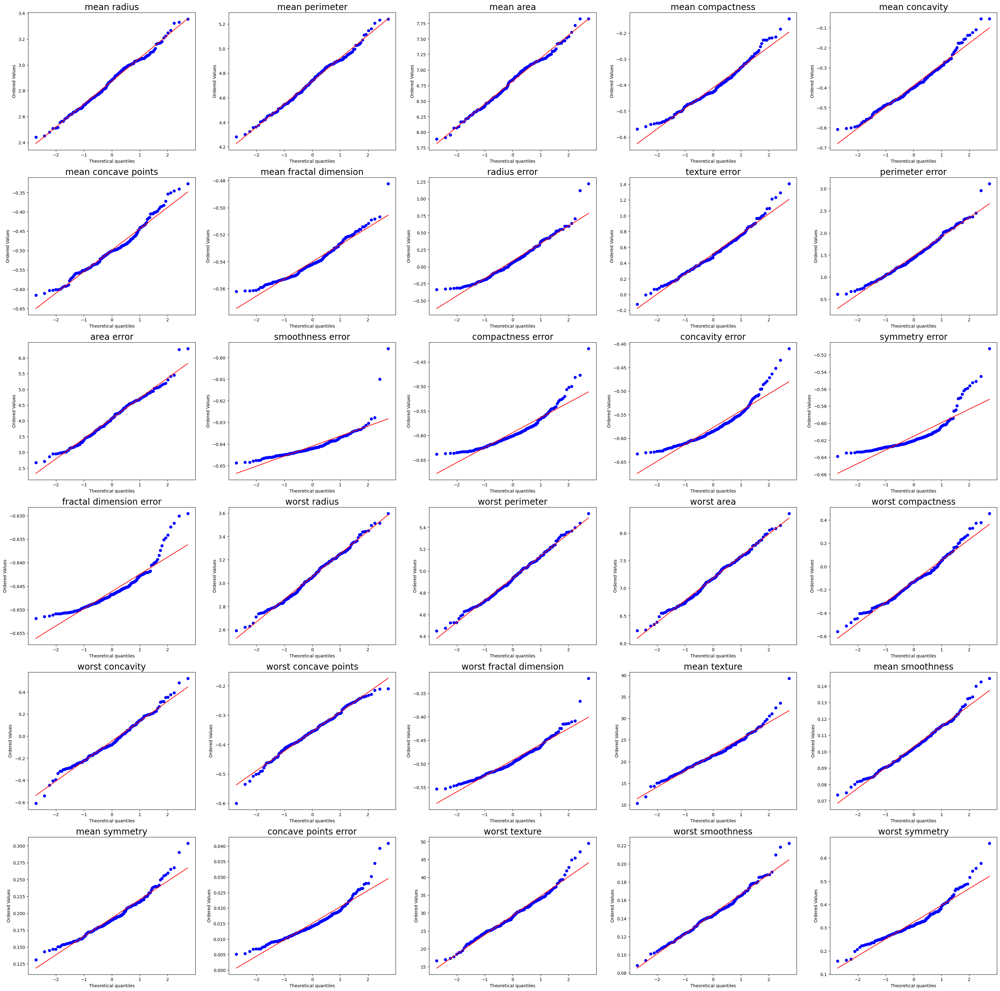

In [33]:
fig, axes = plt.subplots(6,5)

fig.set_size_inches(40,40)

for ax, col  in zip(axes.ravel(),breast_data_transformed):
    stats.probplot(breast_data_transformed[breast_data_transformed.target==1][col], dist = "norm", plot = ax)
    ax.set_title(col, fontsize=20)

#### `Plotting each of the variables for Target population with tumor group as Benign and checking whether the distribution for most of them comes out to be Normal distribution.`

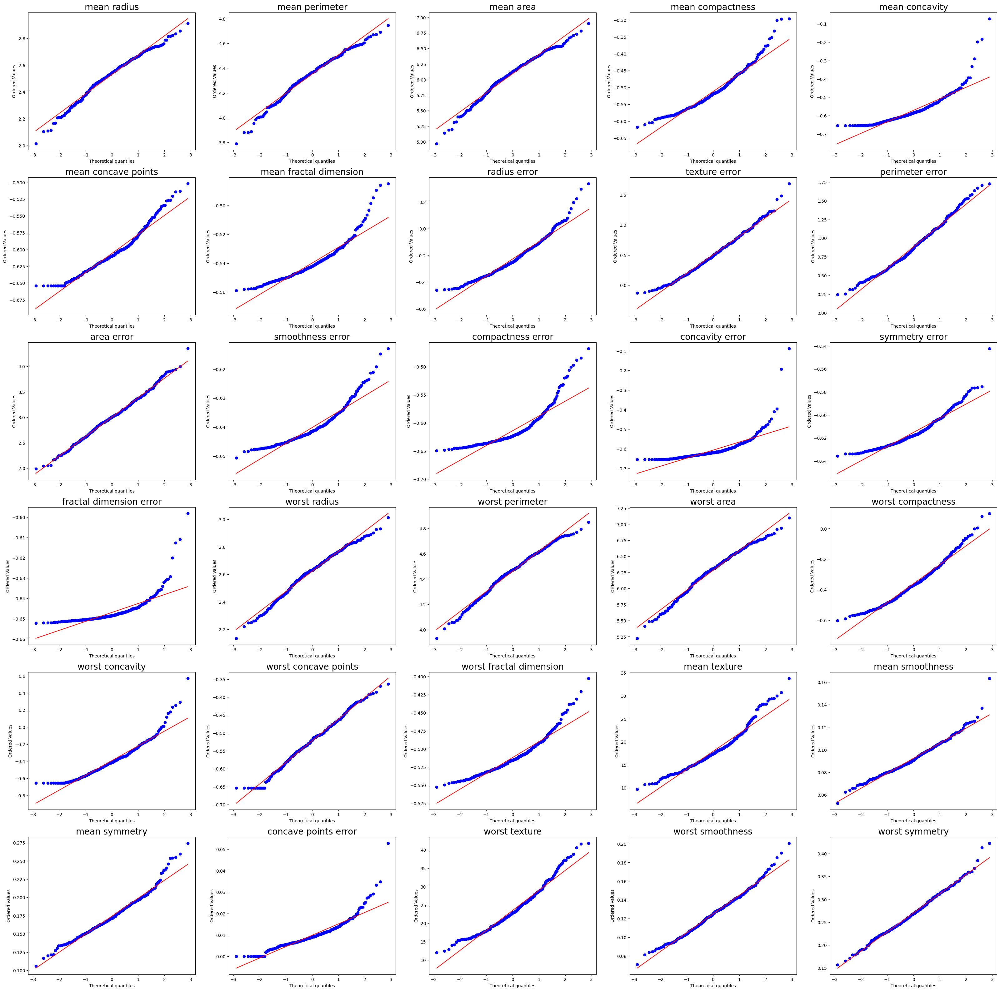

In [34]:
fig, axes = plt.subplots(6,5)

fig.set_size_inches(40,40)

for ax, col  in zip(axes.ravel(),breast_data_transformed):
    stats.probplot(breast_data_transformed[breast_data_transformed.target==0][col], dist = "norm", plot = ax)
    ax.set_title(col, fontsize=20)

#### `Boxplot and Interquartile Range on the Transformed Data`

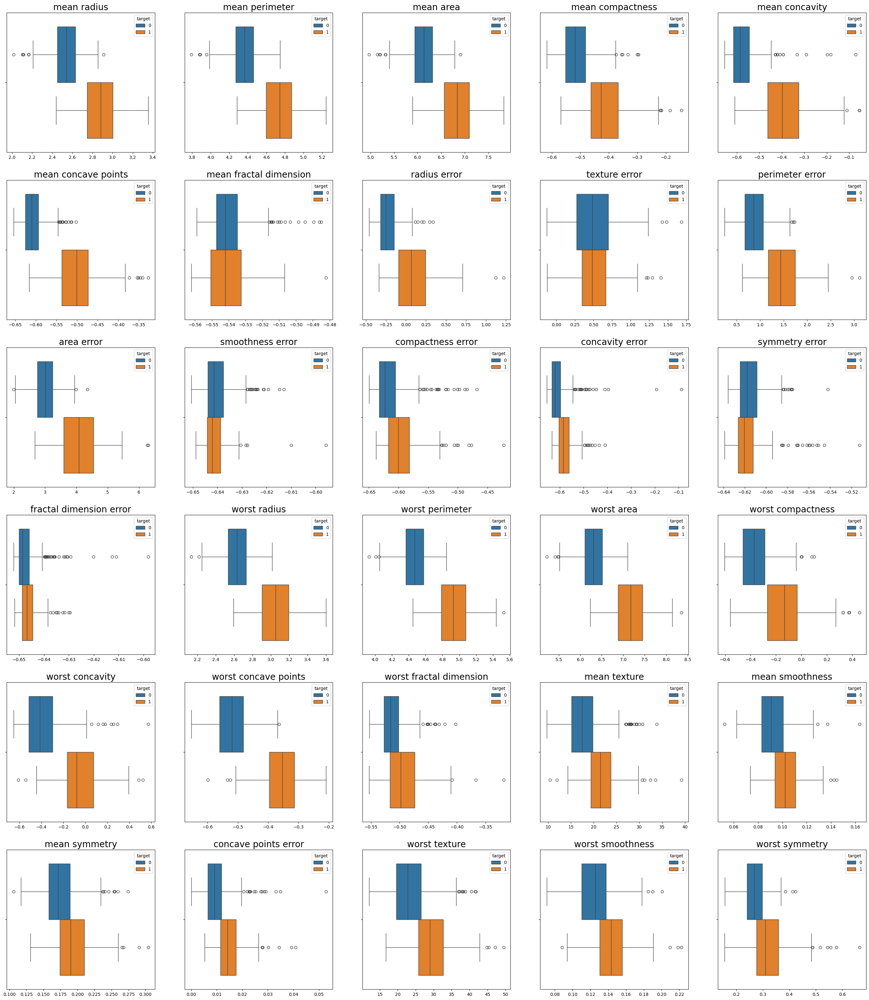

In [35]:
fig, axes = plt.subplots(6,5)
axes = axes.flatten() 
fig.set_size_inches(35,40)

for ax, column in zip(axes,breast_data_transformed.columns):
    sns.boxplot(breast_data_transformed,x=breast_data_transformed[column],hue='target',ax=ax)
    ax.set_title(column,fontsize=20)
    ax.set_xlabel(None)

The outlier plots above indicate that the distribution of the variables **"mean radius", "mean perimeter", "mean area", "mean compactness", "mean concavity", "mean concave points", "radius error", "worst concavity", "worst concave points", "worst area",  "worst concave points"** differ significantly from one another with respect to each class of tumors i.e. malignant tumor (i.e. target =1) vs benign tumor (i.e. target = 0)  

#### `Calculating Inter Quartile Range for each of the variables and understanding what percentage of each of them lies beyond the IQR Range and henceforth will be considered as outliers.`

In [36]:
col_names_iqr, q1_value_iqr, q3_value_iqr, perc_outliers_iqr = [] , [] , [], []


for col in breast_data_transformed.columns[:-1]:  
    col_name = col 
    q1 = breast_data_transformed[col].quantile(0.25)
    q3 = breast_data_transformed[col].quantile(0.75)
    iqr = (q3 - q1)/2

    lower_bound = q1 - (1.5*iqr)
    upper_bound = q3 + (1.5*iqr)

    perc_outlier = np.sum(np.array(breast_data_transformed.apply(lambda x : 1 if ((x[col] > upper_bound) or (x[col] < lower_bound)) else 0,axis=1))) / len(breast_data_transformed)
    
    col_names_iqr.append(col_name), q1_value_iqr.append(q1), q3_value_iqr.append(q3), perc_outliers_iqr.append(perc_outlier)

#### `Calculating the first and 99th percentile for each of the variables and understanding what percentage of each of them lies beyond that range and henceforth will be considered as outliers.`

In [37]:
col_names_p, p1_value_p, p99_value_p, perc_outliers_p = [] , [] , [], []

#breast_data_transformed_outlier_p = breast_data_transformed_outlier.copy()

for col in breast_data_transformed.columns[:-1]:  
    col_name = col 
    p1 = breast_data_transformed[col].quantile(0.01)
    p99 = breast_data_transformed[col].quantile(0.99)

    lower_bound = p1
    upper_bound = p99

    perc_outlier = np.sum(np.array(breast_data_transformed.apply(lambda x : 1 if ((x[col] > upper_bound) or (x[col] < lower_bound)) else 0,axis=1))) / len(breast_data_transformed)
    
    col_names_p.append(col_name), p1_value_p.append(p1), p99_value_p.append(p99), perc_outliers_p.append(perc_outlier)
    

In [38]:
## The table below will help us to understand what percentage of the observations from each variable is an outlier based on the IQR method
    
breast_data_transformed_iqr_summary =  pd.DataFrame({'variable':col_names, 'Q1 i.e. 25th percentile': q1_value_iqr,\
                                             'Q3 i.e. 75th percentile': q3_value_iqr, 'perc_outliers_iqr_method': perc_outliers_iqr})

breast_data_transformed_iqr_summary['perc_outliers_iqr_method'] = breast_data_transformed_iqr_summary['perc_outliers_iqr_method'].apply(lambda x : x*100)


## The table below will help us to understand what percentage of the observations from each variable is an outlier based on the Percentile Method

breast_data_transformed_p_summary =  pd.DataFrame({'variable':col_names_p, 'P1 i.e. 1st Percentile': p1_value_p,\
                                             'P99 i.e. 99th Percentile': p99_value_p, 'perc_outliers_percentile_method': perc_outliers_p})

breast_data_transformed_p_summary['perc_outliers_percentile_method'] = breast_data_transformed_p_summary['perc_outliers_percentile_method'].apply(lambda x : x*100)


breast_data_transformed_iqr_p_summarised = breast_data_transformed_iqr_summary[['variable','perc_outliers_iqr_method']].merge(breast_data_transformed_p_summary[['variable','perc_outliers_percentile_method']],\
                                                                                   how = 'inner', on = 'variable').sort_values(by=['perc_outliers_iqr_method', 'perc_outliers_percentile_method'],ascending=[False, False])

breast_data_transformed_iqr_p_summarised                    


,variable,perc_outliers_iqr_method,perc_outliers_percentile_method
0,mean radius,12.653779,2.108963
29,worst symmetry,11.775044,2.108963
10,area error,11.599297,2.108963
2,mean area,11.423550,2.108963
7,radius error,11.247803,2.108963
11,smoothness error,11.247803,2.108963
14,symmetry error,10.896309,2.108963
28,worst smoothness,10.896309,2.108963
6,mean fractal dimension,10.720562,2.108963
1,mean perimeter,10.544815,2.108963


#### Conclusion :

From the table above we see that the percentage of outlier observations is more than 13% for mean radius , mean area and area error, while based on percentile method we observe that a maximum of 2 % of the observations come as outliers across each of the variables.

In this context, the data we are dealing with contains only 569 observations and any number above 10% is a significant number of observations to be considered as outliers, we might end up rejecting the values which seem to be outliers but are actually influential points

#### `Treating the Outliers for each column such that observations below 1st percentile is replaced by the value of 1st percentile and observations above 99th percentile is replaced by the values of 99th percentile`

In [39]:
breast_data_transformed_outlier_p = breast_data_transformed.copy()

for col in breast_data_transformed_outlier_p.columns[:-1]:
    
    p1 = breast_data_transformed_outlier_p[col].quantile(0.01)
    p99 = breast_data_transformed_outlier_p[col].quantile(0.99)

    lower_bound = p1
    upper_bound = p99

    breast_data_transformed_outlier_p[col] = breast_data_transformed_outlier_p.apply(lambda x : lower_bound if (x[col] < lower_bound) \
                                            else upper_bound if (x[col] > upper_bound) \
                                            else x[col] , axis=1)

## Q6: What are the most correlated variables? How will you quantify? Draw scatter plot for highly correlated columns.

## `The Pearson's correlation coefficient plot for each of the variables aganst the other is seen below :-`

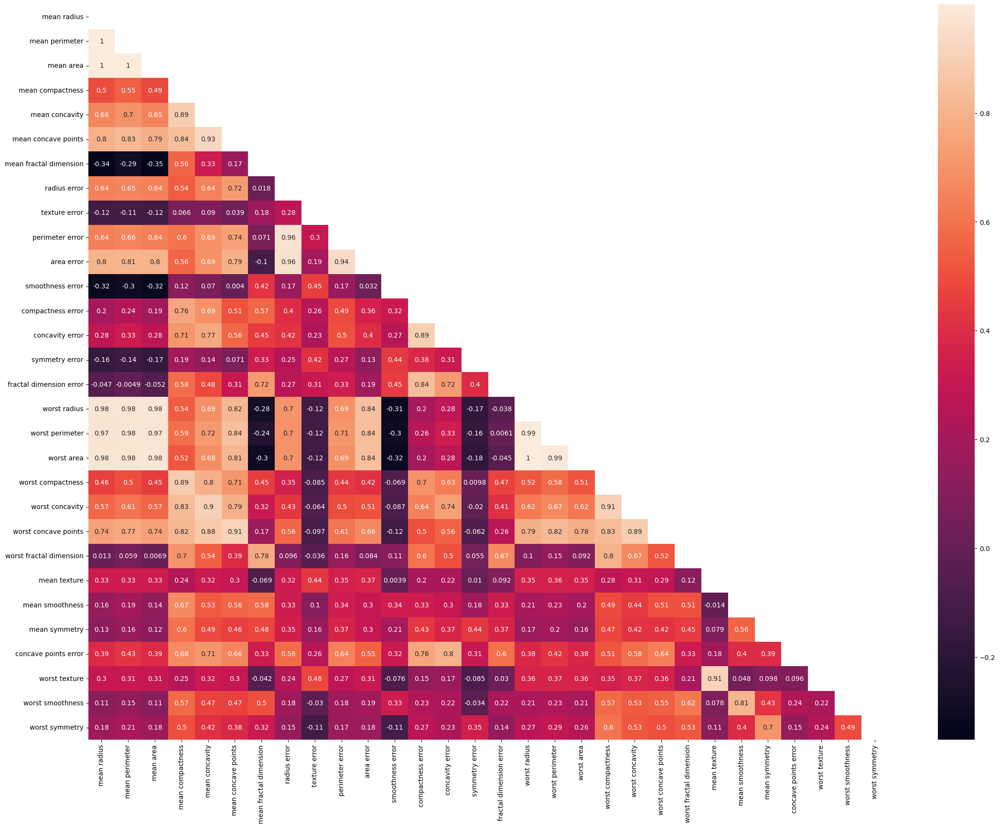

In [40]:
fig, ax = plt.subplots(figsize=(27,20))
corr_heatmap = breast_data_transformed_outlier_p[breast_data_transformed_outlier_p.columns[:-1]].corr()
corr_heatmap_triu = np.triu(corr_heatmap)
sns.heatmap(corr_heatmap ,annot=True,ax=ax, mask = corr_heatmap_triu)
plt.show()

In [41]:
corr_matrix_df = breast_data_transformed_outlier_p[breast_data_transformed_outlier_p.columns[:-1]].corr()
corr_matrix_df.head()

,mean radius,mean perimeter,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension,mean texture,mean smoothness,mean symmetry,concave points error,worst texture,worst smoothness,worst symmetry
mean radius,1.000000,0.997973,0.999528,0.496462,0.658911,0.796735,-0.342672,0.643090,-0.118455,0.638892,0.800183,-0.316271,0.196007,0.284154,-0.158722,-0.047081,0.977044,0.972214,0.977035,0.456505,0.570577,0.741986,0.012733,0.325799,0.155169,0.127752,0.391904,0.303306,0.113789,0.183539
mean perimeter,0.997973,1.000000,0.997142,0.546987,0.697685,0.825155,-0.292846,0.653941,-0.110082,0.656891,0.807804,-0.298484,0.242736,0.325384,-0.141081,-0.004943,0.977815,0.977776,0.977373,0.501297,0.608611,0.771510,0.059315,0.331351,0.192266,0.161169,0.426115,0.309846,0.145519,0.208674
mean area,0.999528,0.997142,1.000000,0.485965,0.653370,0.790434,-0.352545,0.644997,-0.118653,0.640004,0.802825,-0.321263,0.190559,0.280362,-0.165646,-0.052457,0.978426,0.973247,0.979248,0.450473,0.567714,0.737970,0.006885,0.328112,0.144445,0.119330,0.388069,0.306699,0.107749,0.178254
mean compactness,0.496462,0.546987,0.485965,1.000000,0.892105,0.837636,0.561141,0.535195,0.066392,0.602806,0.557778,0.121919,0.756810,0.707224,0.190032,0.584766,0.536401,0.588458,0.523892,0.887768,0.831888,0.819335,0.703222,0.241671,0.667098,0.595251,0.675087,0.250067,0.572430,0.500601
mean concavity,0.658911,0.697685,0.653370,0.892105,1.000000,0.929186,0.330782,0.642885,0.089777,0.688286,0.690091,0.070442,0.687696,0.768272,0.139044,0.481939,0.686606,0.724771,0.679942,0.798507,0.903261,0.877386,0.540814,0.317575,0.529819,0.491977,0.707241,0.315527,0.466124,0.416584


**Quantification Example :**

Let's say as for example, the correlation coefficient between the variables mean radius  and mean perimeter is 0.99786, which implies that the two variables change together in the same direction and the association is very strong between them

#### `Create a function to get the most correlated variables i.e. variables with correlation greater or equal to 0.8`

In [42]:
v1s = []
v2s = []
corr_lists = []
for i in corr_matrix_df.index:
    for j in corr_matrix_df.columns:
        if corr_matrix_df[i][j]>=0.8 or corr_matrix_df[i][j]<= -0.8  :
            v1 = i
            v2 = j
            corr_list = corr_matrix_df[i][j]

            v1s.append(v1)
            v2s.append(v2)
            corr_lists.append(corr_list)

In [43]:
corr_matrix_df_hc = pd.DataFrame({'variable1':v1s,'variable2': v2s,'correlation':corr_lists})
corr_matrix_df_hc.head()

,variable1,variable2,correlation
0,mean radius,mean radius,1.000000
1,mean radius,mean perimeter,0.997973
2,mean radius,mean area,0.999528
3,mean radius,area error,0.800183
4,mean radius,worst radius,0.977044


In [44]:
corr_matrix_df_hc = corr_matrix_df_hc[~(corr_matrix_df_hc.variable1 == corr_matrix_df_hc.variable2)]
corr_matrix_df_hc.head()

,variable1,variable2,correlation
1,mean radius,mean perimeter,0.997973
2,mean radius,mean area,0.999528
3,mean radius,area error,0.800183
4,mean radius,worst radius,0.977044
5,mean radius,worst perimeter,0.972214


In [45]:
corr_matrix_df_hc_updated = corr_matrix_df_hc.groupby('variable1').agg(list).reset_index()

In [46]:
corr_matrix_df_hc_updated['len_var2'] = corr_matrix_df_hc_updated.apply(lambda x : len(x['variable2']),axis=1)
corr_matrix_df_hc_updated = corr_matrix_df_hc_updated.sort_values('len_var2',ascending=False)
corr_matrix_df_hc_updated = corr_matrix_df_hc_updated.reset_index(drop=True)
corr_matrix_df_hc_updated.head(15)

,variable1,variable2,correlation,len_var2
0,area error,"[mean radius, mean perimeter, mean area, radiu...","[0.8001828534969613, 0.8078037997799195, 0.802...",8
1,worst perimeter,"[mean radius, mean perimeter, mean area, mean ...","[0.9722138796962211, 0.977776127031241, 0.9732...",8
2,mean concave points,"[mean perimeter, mean compactness, mean concav...","[0.825155323623313, 0.8376356448488779, 0.9291...",7
3,mean perimeter,"[mean radius, mean area, mean concave points, ...","[0.9979732590370585, 0.9971419259256817, 0.825...",7
4,worst area,"[mean radius, mean perimeter, mean area, mean ...","[0.9770352660951648, 0.9773731682537085, 0.979...",7
5,worst radius,"[mean radius, mean perimeter, mean area, mean ...","[0.9770439041646042, 0.977814679490024, 0.9784...",7
6,mean area,"[mean radius, mean perimeter, area error, wors...","[0.9995283191652351, 0.9971419259256817, 0.802...",6
7,mean radius,"[mean perimeter, mean area, area error, worst ...","[0.9979732590370585, 0.9995283191652351, 0.800...",6
8,worst concave points,"[mean compactness, mean concavity, mean concav...","[0.8193351242746891, 0.8773857095999004, 0.914...",6
9,mean compactness,"[mean concavity, mean concave points, worst co...","[0.8921049764104767, 0.8376356448488779, 0.887...",5


In [47]:
corr_matrix_df_hc_updated[corr_matrix_df_hc_updated.len_var2>=5]['variable1'].tolist()

['area error',
 'worst perimeter',
 'mean concave points',
 'mean perimeter',
 'worst area',
 'worst radius',
 'mean area',
 'mean radius',
 'worst concave points',
 'mean compactness']

**Although we do observe a significant number of features to be strongly collinear in nature, since in this case the purpose is to predict a particular tumor type as "malignant" and the role of each variable is not important, we are not treating multicollinearity for now.**

#### `Scatter plots for the variables having high correlation (>= 0.8) with each other`

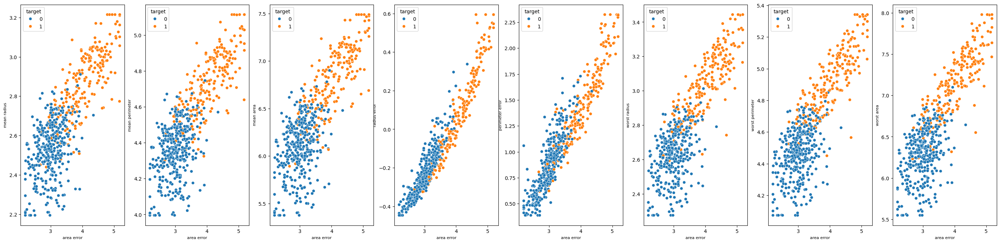

In [48]:
k = 0
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

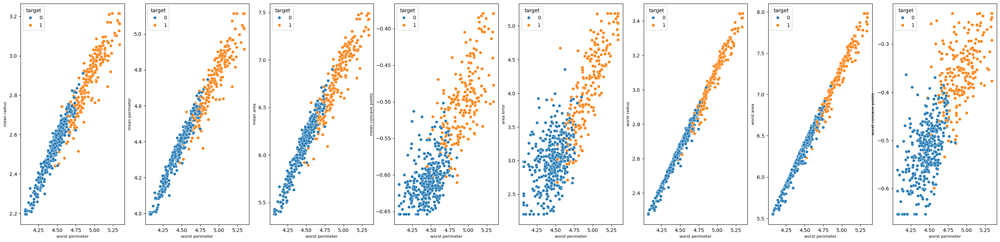

In [49]:
k = 1
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

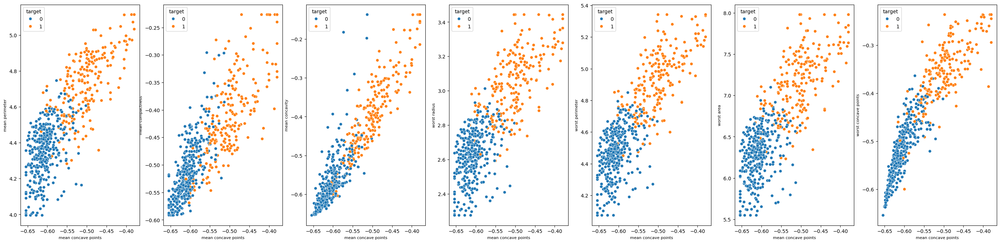

In [50]:
k = 2
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

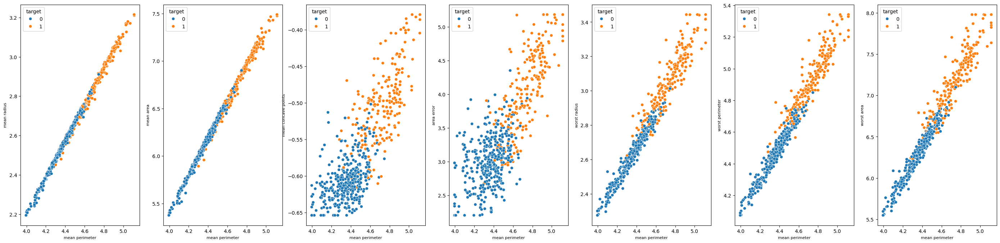

In [51]:
k = 3
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

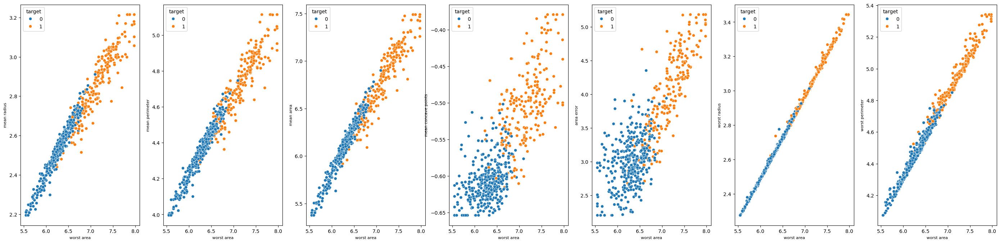

In [52]:
k = 4
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

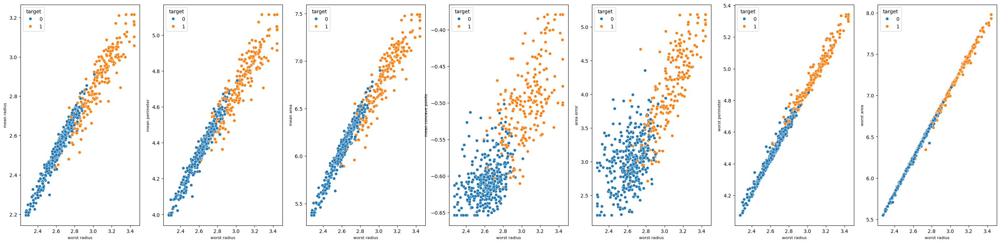

In [53]:
k = 5
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

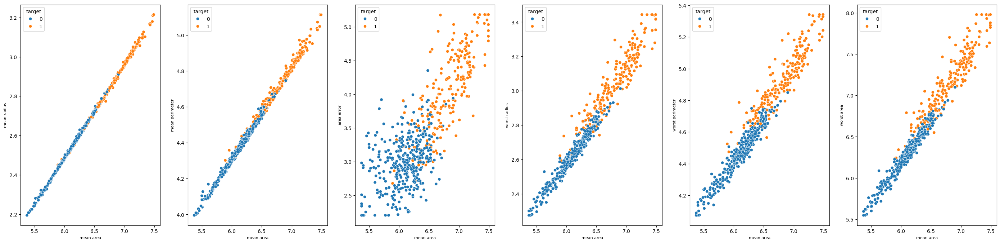

In [54]:
k = 6
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

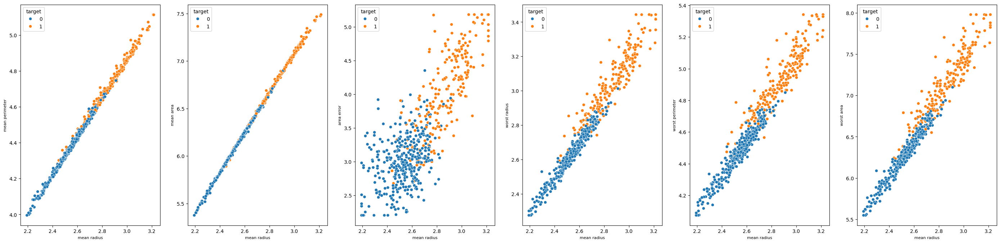

In [55]:
k = 7
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

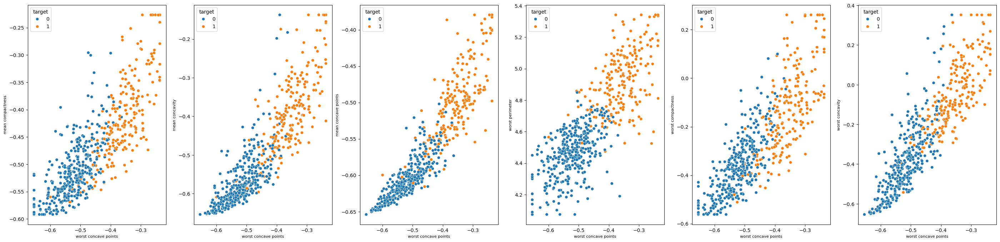

In [56]:
k = 8
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)
    #plt.savefig("scatterplots for high correlated variables.pdf")

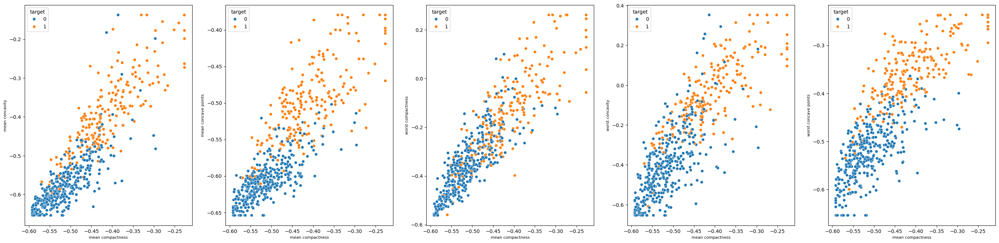

In [57]:
k = 9
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

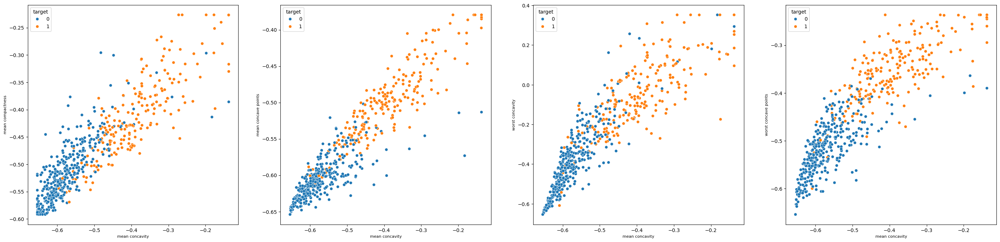

In [58]:
k = 10
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

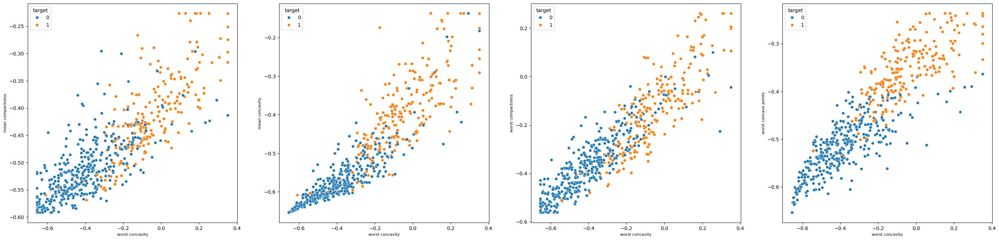

In [59]:
k = 11
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

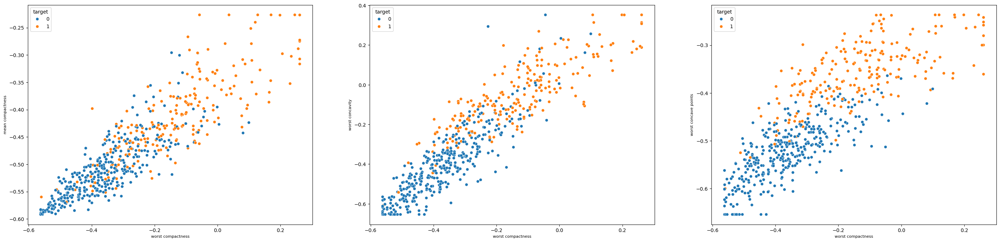

In [60]:
k = 12
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

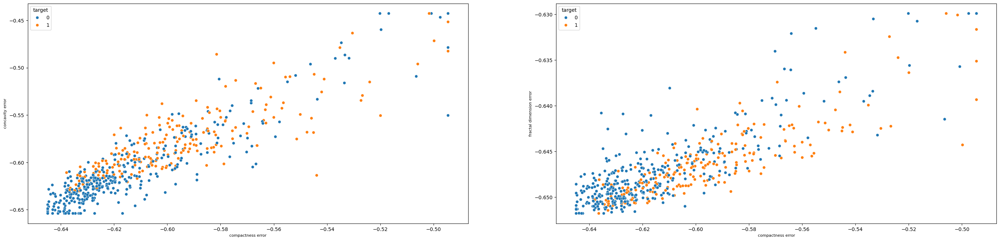

In [61]:
k = 13
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

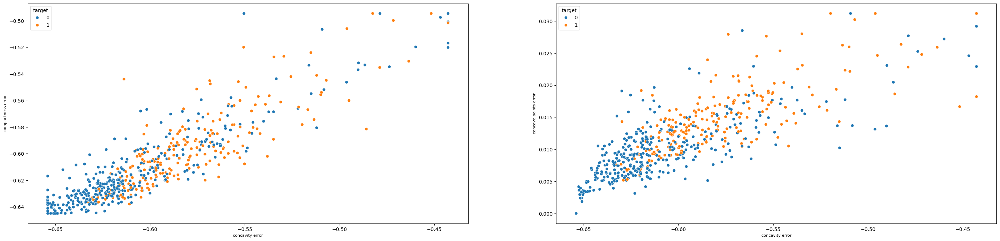

In [62]:
k = 14
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

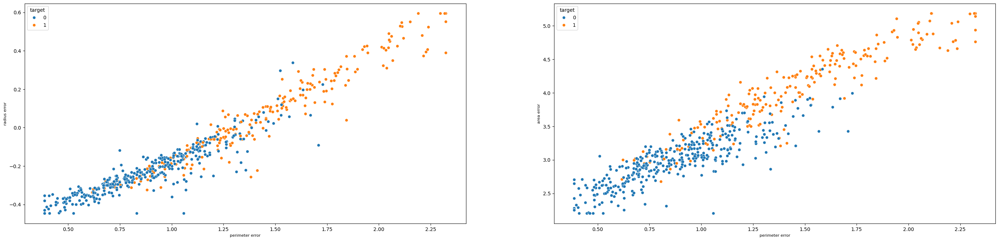

In [63]:
k = 15
fig, axes = plt.subplots(1,corr_matrix_df_hc_updated.len_var2[k])
axes = axes.flatten() 
fig.set_size_inches(35,8)
    
col1 = corr_matrix_df_hc_updated.variable1[k]
for ax, column in zip(axes,[i for i in breast_data_transformed.columns if i in corr_matrix_df_hc_updated.variable2[k]]):
    sns.scatterplot(breast_data_transformed_outlier_p, x=col1, y=column, hue='target',ax=ax)
    ax.set_title(None)
    ax.set_xlabel(col1,fontsize=8)
    ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

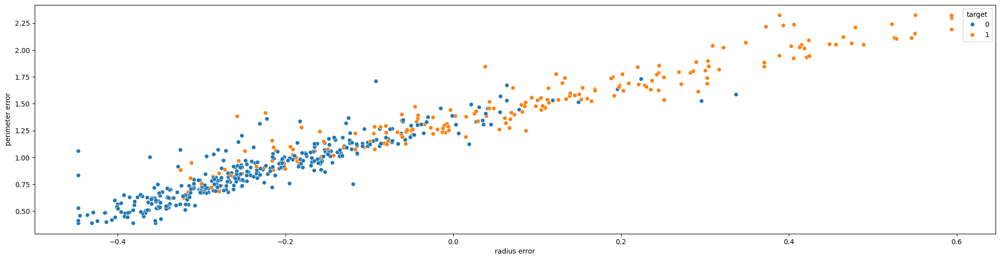

In [64]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[16], y=corr_matrix_df_hc_updated.variable2[16][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

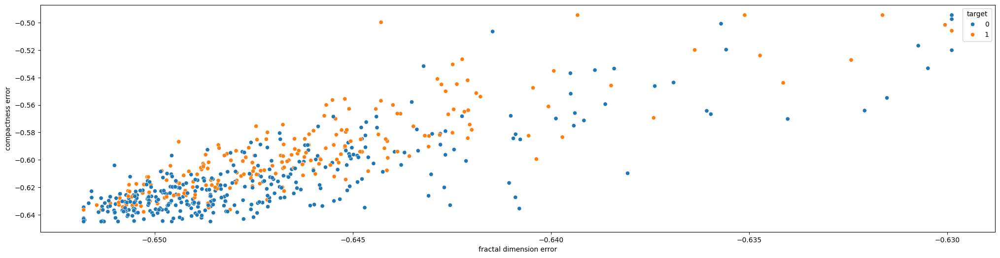

In [65]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[17], y=corr_matrix_df_hc_updated.variable2[17][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

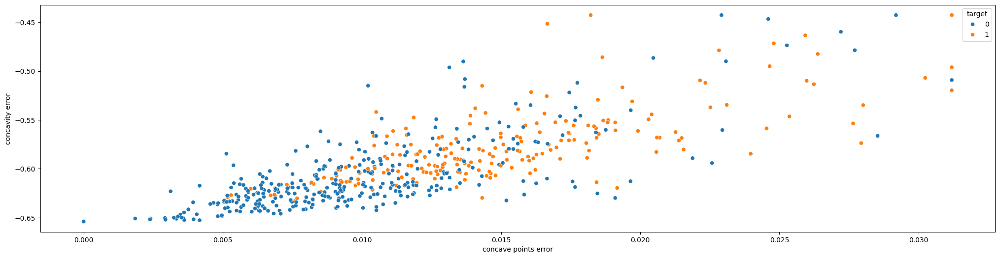

In [66]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[18], y=corr_matrix_df_hc_updated.variable2[18][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

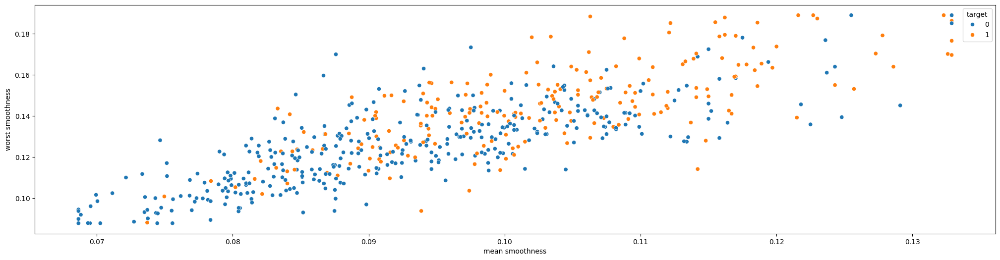

In [67]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[19], y=corr_matrix_df_hc_updated.variable2[19][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

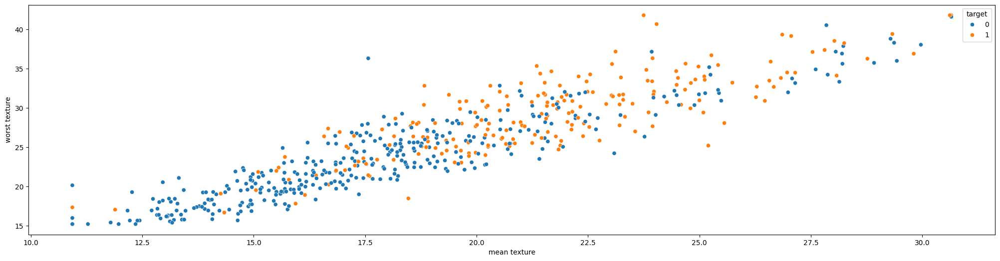

In [68]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[20], y=corr_matrix_df_hc_updated.variable2[20][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

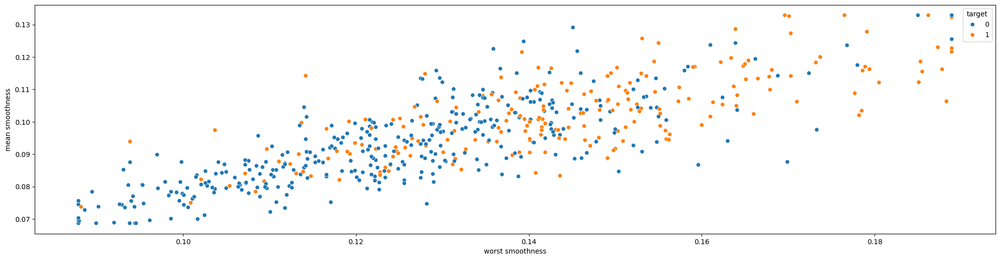

In [69]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[21], y=corr_matrix_df_hc_updated.variable2[21][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Text(1511.1704545454543, 0.5, 'area error')

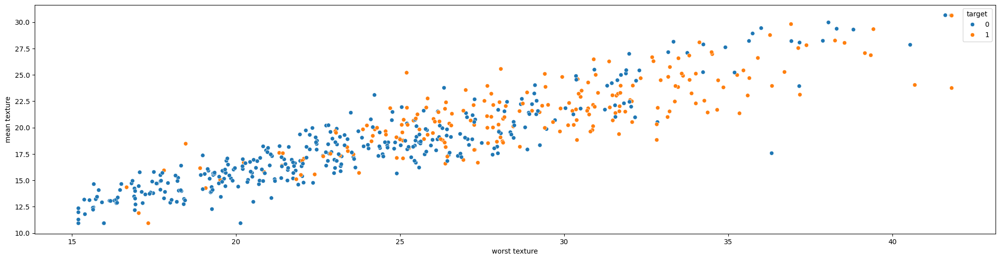

In [70]:
fig, axes = plt.subplots(1,1)

fig.set_size_inches(25,6)
    
sns.scatterplot(breast_data_transformed_outlier_p, x=corr_matrix_df_hc_updated.variable1[22], y=corr_matrix_df_hc_updated.variable2[22][0], hue='target')

ax.set_title(None)
ax.set_xlabel(col1,fontsize=8)
ax.set_ylabel(column,fontsize=8)

Based on the above analysis, variables like **"mean radius", "mean area", "worst area", "worst radius", "mean perimeter", "mean concave points" and "area error"** have high correlation with most of the other variables. Therefore, we can consider removing these variables in the final model as the presence of these might lead to te problem of multicollinearity in the data

## Q7. Can you scale the variables to make it comparable? Use any 2 ways.

Feature scaling is a preprocessing technique that transforms feature values to a similar scale,
ensuring all features contribute equally to the model.It is required for datasets with features of varying ranges, 
units, or magnitudes. Common techniques include standardization, normalization, and min-max scaling.
This process improves model performance, convergence, and prevents bias from features with larger values.

In this section, we will try out two different methods for feature scaling :-

a. **Standardisation** : This involves calculating mean nd standard deviation of the data we would like to normalize. Then we subtract the mean value from     each entry and divide by standard deviation.
   We can use standardisation for feature scaling as we have already reduced skewness across the different variables through cube root transaformation     technique which has made the distributions close to symmetric.

    Scaled value Formula : (Original Value - Input's Mean)/Standard Deviation
                           
b. **Robust Normalization**: Robust scaling answers the question of how far each data point is from the input's median 

    Scaled value Formula : (Original Value - Input's Median)/ Input's IQR

In [71]:
## Standard Scaler

scaler = StandardScaler()
model = scaler.fit(breast_data_transformed_outlier_p[breast_data_transformed_outlier_p.columns[:-1]])
breast_data_transformed_scaled_std = model.transform(breast_data_transformed_outlier_p[breast_data_transformed_outlier_p.columns[:-1]])
breast_data_transformed_scaled_std[:1]

array([[ 1.15850491,  1.30335565,  1.15343873,  3.09576792,  2.5394448 ,
         2.49502254,  2.36606052,  2.54536654, -0.53953878,  2.51989239,
         2.34861766, -0.21640977,  1.39952345,  1.00424162,  1.23913057,
         1.13751905,  1.77791045,  2.04205601,  1.8152048 ,  2.44078943,
         1.95602238,  2.15354335,  2.04363042, -1.98920556,  1.63156088,
         2.29418492,  0.71791973, -1.39027112,  1.35231644,  2.92323474]])

In [72]:
## Robust Scaler

scaler = RobustScaler()
model = scaler.fit(breast_data_transformed_outlier_p[breast_data_transformed_outlier_p.columns[:-1]])
breast_data_transformed_robust_scaled= model.transform(breast_data_transformed_outlier_p[breast_data_transformed_outlier_p.columns[:-1]])
breast_data_transformed_robust_scaled[:1]

array([[ 0.99670526,  1.08634293,  0.96008793,  2.48165292,  2.03483694,
         1.97050408,  2.01091204,  2.28910209, -0.3434555 ,  1.95923547,
         1.99162216,  0.0063855 ,  1.44428542,  1.01191222,  1.34557052,
         1.29810822,  1.44511831,  1.59604634,  1.4509502 ,  1.90810518,
         1.41917698,  1.54978856,  1.83115189, -1.40490231,  1.19017433,
         1.85502959,  0.69852941, -0.93518519,  1.05102041,  2.63555556]])

In [73]:
X_robust_scaled = pd.DataFrame(breast_data_transformed_robust_scaled, columns =breast_data_transformed_outlier_p.columns[:-1])
X_robust_scaled.head()

,mean radius,mean perimeter,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension,mean texture,mean smoothness,mean symmetry,concave points error,worst texture,worst smoothness,worst symmetry
0,0.996705,1.086343,0.960088,2.481653,2.034837,1.970504,2.010912,2.289102,-0.343456,1.959235,1.991622,0.006385,1.444285,1.011912,1.345571,1.298108,1.445118,1.596046,1.450950,1.908105,1.419177,1.549789,1.831152,-1.404902,1.190174,1.855030,0.698529,-0.935185,1.051020,2.635556
1,1.449645,1.329538,1.412497,-0.217701,0.252673,0.677131,-0.581180,0.814898,-0.674393,0.555017,1.197092,-0.388604,-0.384704,-0.273504,-0.584988,0.149363,1.402465,1.218328,1.408303,-0.139161,0.056007,0.851637,0.433477,-0.190053,-0.587956,0.059172,0.349265,-0.231481,-0.255102,-0.106667
2,1.301700,1.261647,1.255853,0.981831,1.242840,1.662242,-0.184445,1.428833,-0.567461,0.995481,1.457062,-0.077316,0.998609,0.458029,0.452032,0.598589,1.241454,1.116792,1.226701,1.008767,0.742811,1.360246,0.364398,0.428064,0.725304,0.819527,1.364536,0.013889,0.445578,1.171852
3,-0.525094,-0.324867,-0.572138,2.481653,1.595204,1.285778,2.782974,0.652273,0.075055,0.574864,0.112289,0.915140,2.674400,1.113776,3.907862,2.592675,-0.010910,0.030826,-0.255478,2.268270,1.361059,1.483565,2.807048,0.273535,1.955520,2.377633,1.094457,0.126157,1.959456,3.032711
4,1.403252,1.380064,1.376914,0.598512,1.247788,1.270572,-0.322805,1.461029,-0.578552,1.252654,1.461808,1.709111,0.214836,1.123300,-0.140929,0.833441,1.118610,1.111853,1.116859,-0.037470,0.591625,0.629881,-0.158971,-0.799290,0.234020,0.050296,1.119910,-1.011574,0.207483,-0.678519


#### Let us check the VIF for each of the predictor variables and reject the ones which have a high VIF as well as high correlation with other predictors

**What is VIF and how it can be used to treat Multicollinearity ?**

Multicollinearity is a common problem in regression analysis, where two or more independent variables are highly correlated. This issue can lead to inaccurate predictions and misinterpretation of the model, as it inflates the standard errors of regression coefficients, causing unreliable estimates. To effectively detect multicollinearity, the Variance Inflation Factor (VIF) is widely used.

VIF quantifies the level of multicollinearity by measuring how much the variance of a regression coefficient increases due to the correlation between predictor variables. A high VIF value signals that multicollinearity is present, affecting the stability of the model. In this article, we will explore how to detect multicollinearity using the Variance Inflation Factor (VIF).

In [78]:
def calculate_vif(dataframe):
    vif =pd.DataFrame()
    vif['Feature']=dataframe.columns
    vif['VIF']=[variance_inflation_factor(dataframe.values,i) for i in range(dataframe.shape[1])]
    return vif

In [79]:
vif_df = calculate_vif(X_robust_scaled)
vif_df = vif_df.sort_values(by='VIF',ascending=False,ignore_index= True)
vif_df

,Feature,VIF
0,mean area,4957.229226
1,mean perimeter,4815.327338
2,mean radius,4260.109621
3,worst area,1509.946513
4,worst radius,1508.634110
5,worst perimeter,469.697235
6,area error,88.561123
7,mean concavity,58.997392
8,worst compactness,58.558183
9,radius error,56.387707


In [80]:
list(vif_df['Feature'][:5])

['mean area', 'mean perimeter', 'mean radius', 'worst area', 'worst radius']

#### Ignoring X variables where VIF and correlation coefficient is pretty high with other variables

In [81]:
X_robust_scaled_r = X_robust_scaled[X_robust_scaled.columns[~X_robust_scaled.columns.isin(list(vif_df['Feature'][:5]))]]

In [82]:
Y_robust_scaled = pd.DataFrame(np.array(breast_data_transformed_outlier_p['target'])).rename(columns={0:'target'})

In [83]:
Y_robust_scaled.target.unique()

array([1, 0])

## Q8:  Choose the best features/variables that have clear relationship with target.

#### `To do this, let's first divide let's first divide the data into training and testing set with the scaled features`

##### Reasoning to perform feature selection on the training data only :

Ideally we must do feature selection after splitting the data into training and testing set and only on the training data. Let's say when we are to predict the target variable for any random new set of predictor variables , if we do feature selection on the entire data and then check for accuracy as a measure on the test set we might end up getting a very high accuracy but here we are assuming by default that the test data is seen already where in reality the test data is completely unknown to us. This prevents information leakage from the test set and ensures that the model's performance evaluation is unbiased.

Based on the previous analysis above , variables like :

1. **"worst concavity"** is not highly correlated (correlation>=0.8) with any other feature except for one or two indicating the fact that it is not heavily dependent on most of the features ; univeriate analysis also suggested that it's distribution significantly differs between the two groups of the target population; again for a fact the bivariate relationships that can be seen from the pairplot above indicates how precisely, compared to all other features, we are able to distinguish the two target population distinctively.
2.  Similar thing we have observed for **"worst concave points", "worst perimeter",  "worst compactness", "mean concave points" and "mean concavity"** as well

Let's further delve into feature selection techniques like :-

a. **Feature Importance from Random Forest Model to understand more on the same**\
     The importance assigned to the features is influenced by correlation among features . Let's say for example ina decision tree model if 2 features are identical or highly co-linear, any of the 2 can be taken to make a split at a certain node, and hence it's importance will be higher than that of the second feature. This is just random. If we create an ensemble, there will be decision trees that use the first feature and decision trees using the second feature , and thus, the importance of each feature would be halfof what it would be if each feature was by itself in the data.

b. **Recursive Feature Elimination**\
    Compared to selecting features based on feature importance, this method has the advantage that it considers the re-adjustments in importance after a feature or a small subset of features is removed. Thus it is better suited to handling features that are highly correlated. Hence, in our case it will be one of the ideal ways for Feature Elimination.



### `8.1 Train - Test Split`

As we have already observed above that  our data is slightly imbalanced i.e. 62% of the observations belong to tumor type as benign indicated by the target variable as 0 and 38% belong to tumor type as "malignant" indicated by the target variable as 1. Therefore, for the train-test split we must ensure that the proportion of observations by each class of the target variable is preserved in both the train and test set.

In [84]:
X_robust_scaled[X_robust_scaled.columns[~X_robust_scaled.columns.isin(['mean radius','mean perimeter'])]].head()

,mean area,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst radius,worst perimeter,worst area,worst compactness,worst concavity,worst concave points,worst fractal dimension,mean texture,mean smoothness,mean symmetry,concave points error,worst texture,worst smoothness,worst symmetry
0,0.960088,2.481653,2.034837,1.970504,2.010912,2.289102,-0.343456,1.959235,1.991622,0.006385,1.444285,1.011912,1.345571,1.298108,1.445118,1.596046,1.450950,1.908105,1.419177,1.549789,1.831152,-1.404902,1.190174,1.855030,0.698529,-0.935185,1.051020,2.635556
1,1.412497,-0.217701,0.252673,0.677131,-0.581180,0.814898,-0.674393,0.555017,1.197092,-0.388604,-0.384704,-0.273504,-0.584988,0.149363,1.402465,1.218328,1.408303,-0.139161,0.056007,0.851637,0.433477,-0.190053,-0.587956,0.059172,0.349265,-0.231481,-0.255102,-0.106667
2,1.255853,0.981831,1.242840,1.662242,-0.184445,1.428833,-0.567461,0.995481,1.457062,-0.077316,0.998609,0.458029,0.452032,0.598589,1.241454,1.116792,1.226701,1.008767,0.742811,1.360246,0.364398,0.428064,0.725304,0.819527,1.364536,0.013889,0.445578,1.171852
3,-0.572138,2.481653,1.595204,1.285778,2.782974,0.652273,0.075055,0.574864,0.112289,0.915140,2.674400,1.113776,3.907862,2.592675,-0.010910,0.030826,-0.255478,2.268270,1.361059,1.483565,2.807048,0.273535,1.955520,2.377633,1.094457,0.126157,1.959456,3.032711
4,1.376914,0.598512,1.247788,1.270572,-0.322805,1.461029,-0.578552,1.252654,1.461808,1.709111,0.214836,1.123300,-0.140929,0.833441,1.118610,1.111853,1.116859,-0.037470,0.591625,0.629881,-0.158971,-0.799290,0.234020,0.050296,1.119910,-1.011574,0.207483,-0.678519


In [85]:
#X_scaled = breast_data_transformed_robust_scaled
y = breast_data_transformed_outlier_p['target']

In [86]:
X_train, X_test, y_train, y_test = tts(X_robust_scaled_r, y, test_size = 0.25, stratify = y, random_state = 42)

In [87]:
X_train.head(2)

,mean compactness,mean concavity,mean concave points,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,symmetry error,fractal dimension error,worst perimeter,worst compactness,worst concavity,worst concave points,worst fractal dimension,mean texture,mean smoothness,mean symmetry,concave points error,worst texture,worst smoothness,worst symmetry
251,-0.517265,-0.369175,-0.247167,-0.261940,0.275305,-0.459088,0.220172,0.102760,0.000000,-0.512713,-0.507132,0.502197,-0.748729,-0.403366,-0.625218,-0.615082,-0.374976,-0.747228,-0.069272,-0.127839,0.124260,-0.248162,-0.341435,-0.442177,-0.121481
373,0.227512,0.862008,1.015762,-0.808053,1.040460,-0.836771,0.836162,1.239494,-0.056807,-0.077871,0.034256,-0.722329,-0.640127,1.341626,0.476058,0.640197,1.081379,-0.465203,-0.264654,-0.074485,-0.653846,0.196550,-0.259259,0.846939,-0.197037


In [88]:
classifier_RF = RandomForestClassifier(random_state=42)

In [89]:
model_RF = classifier_RF.fit(X_train, y_train)

#### a. `Mean Decrease in Gini Impurity`i.e. Feature Importance using Random Forest Model

**Gini Importance :**

Also called `Mean Decrease in Impurity` and it measures how much a feature reduces uncertainty in a decision tree. Calculated by summing up the decrease in node impurity across all trees in an ensemble and weightedby the probability of reaching that node. It considers conditional interactions between variables and is invariant to the scaling of individual variables.

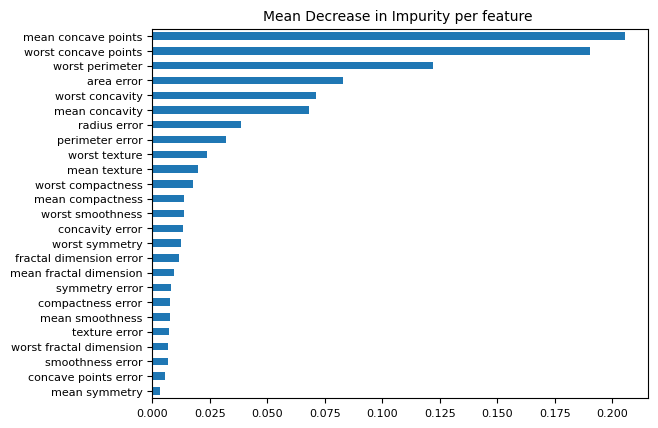

In [90]:
fig.set_size_inches(10,4)

feature_importance_RF = pd.Series(model_RF.feature_importances_, index =X_robust_scaled_r.columns).sort_values(ascending=True)
feature_importance_RF.plot(kind='barh',fontsize=8)
plt.title('Mean Decrease in Impurity per feature ',fontsize=10)
plt.show()

In [91]:
feature_imp_rf_df = pd.DataFrame(feature_importance_RF).reset_index().rename(columns={'index':'Variables', 0: 'Mean Decrease in Gini Impurity'}).sort_values('Mean Decrease in Gini Impurity',ascending=False)
feature_imp_rf_df = feature_imp_rf_df[:15]

In [92]:
feature_imp_rf_df.head()

,Variables,Mean Decrease in Gini Impurity
24,mean concave points,0.205377
23,worst concave points,0.190101
22,worst perimeter,0.121818
21,area error,0.083086
20,worst concavity,0.070951


#### b. `Recursive Feature Elimination Method`

In [93]:
rfe_RF = RFE(classifier_RF, n_features_to_select=15, step=1)
model_RF_RFE = rfe_RF.fit(X_train, y_train)
indices_cols = model_RF_RFE.get_support(indices=True)

In [94]:
indices_cols

array([ 0,  1,  2,  4,  6,  7, 12, 13, 14, 15, 16, 18, 22, 23, 24])

In [95]:
X_robust_scaled_r.columns[indices_cols]

Index(['mean compactness', 'mean concavity', 'mean concave points',
       'radius error', 'perimeter error', 'area error',
       'fractal dimension error', 'worst perimeter', 'worst compactness',
       'worst concavity', 'worst concave points', 'mean texture',
       'worst texture', 'worst smoothness', 'worst symmetry'],
      dtype='object')

#### `Top Features Identified by both the methods who are significantly related with the target variable`

In [96]:
top_features_by_methods = pd.DataFrame({'Features from RFE method': list(X_robust_scaled_r.columns[indices_cols][:15]), \
             'Features from Gini Impurity Feature Importance RF': list(feature_imp_rf_df.Variables.unique())})

top_features_by_methods

,Features from RFE method,Features from Gini Impurity Feature Importance RF
0,mean compactness,mean concave points
1,mean concavity,worst concave points
2,mean concave points,worst perimeter
3,radius error,area error
4,perimeter error,worst concavity
5,area error,mean concavity
6,fractal dimension error,radius error
7,worst perimeter,perimeter error
8,worst compactness,worst texture
9,worst concavity,mean texture


#### List of Best Features for the models

In [97]:
best_features_list = [i for i in list(top_features_by_methods[top_features_by_methods.columns[0]].unique()) if i in \
list(top_features_by_methods[top_features_by_methods.columns[1]].unique())]
best_features_list

['mean compactness',
 'mean concavity',
 'mean concave points',
 'radius error',
 'perimeter error',
 'area error',
 'worst perimeter',
 'worst compactness',
 'worst concavity',
 'worst concave points',
 'mean texture',
 'worst texture',
 'worst smoothness',
 'worst symmetry']

In [98]:
#breast_data_transformed_robust_scaled

## Q9: Using the best features train a baseline logistic, XGBoost & Random Forest model and report key model statistics.

## Q10: Use required evaluation matrices to compare the model and find the best out of three. Explain why it is the best performing model.

## Q11:  Use hyperparameters to further tune and model and report key model statistics.

### Baseline Models

#### Logistic Regression Model

`Model Fitting on Train Data`

In [99]:
classifier_lor_base = lor(random_state=42)

In [100]:
model_lor_base = classifier_lor_base.fit(X_train[[i for i in X_train.columns if i in best_features_list]],y_train)
print('Accuracy on train set containing unbalanced data : {:.1f}%'.format(classifier_lor_base.score(X_train[[i for i in X_train.columns if i in best_features_list]], y_train)*100))

Accuracy on train set containing unbalanced data : 97.7%


`Model Performance Check on Validation Set`

In [101]:
kf=StratifiedKFold(n_splits=5)
validation_set_score_lor=cross_val_score(model_lor_base,X_train[[i for i in X_train.columns if i in best_features_list]],y_train,scoring='accuracy',cv=kf)

print("Average Cross Validation accuracy is :{:.1f}%".format(validation_set_score_lor.mean()*100))

Average Cross Validation accuracy is :97.2%


Since the accuracy both in the training set and validation set does not differ much, we can proceed to use this model in our test set for prediction purpose.

`Predicting on Test Data`

In [102]:
predictions_lor_base = classifier_lor_base.predict(X_test[[i for i in X_test.columns if i in best_features_list]])
# evaluate predictions
accuracy_lor_base = accuracy_score(y_test, predictions_lor_base)
print("Accuracy on test set :{:.1f}%".format(accuracy_lor_base * 100))

Accuracy on test set :97.2%


`Model Evaluation Methods`

In [103]:
# confusion matrix in sklearn

# actual values
actual_lor_base = y_test.values.tolist()
# predicted values
predicted_lor_base = predictions_lor_base.tolist()

# confusion matrix
con_matrix_lor_base = confusion_matrix(actual_lor_base,predicted_lor_base)
print('Confusion matrix : \n',con_matrix_lor_base)

# outcome values order in sklearn
tn_lor_base, fp_lor_base, fn_lor_base, tp_lor_base  = con_matrix_lor_base.ravel()
print("\nTPR or Sensitivity or Recall is {:.2f}".format(tp_lor_base/(tp_lor_base+fn_lor_base)),\
      "\nPrecision is {:.2f}".format(tp_lor_base/(tp_lor_base+fp_lor_base)), "\nFNR is {:.2f}".format(fn_lor_base/(fn_lor_base+tp_lor_base)),\
      "\nFPR or (1-Specificity) is {:.2f}".format(fp_lor_base/(fp_lor_base+tn_lor_base)),"\nTNR is {:.2f}".format(tn_lor_base/(tn_lor_base+fp_lor_base)),\
      "\nPrecision is {:.2f}".format(tp_lor_base/(tp_lor_base+fp_lor_base)))


# classification report for precision, recall f1-score and accuracy
matrix_lor_base = classification_report(actual_lor_base,predicted_lor_base)
print('\nClassification report : \n',matrix_lor_base)

Confusion matrix : 
 [[89  1]
 [ 3 50]]

TPR or Sensitivity or Recall is 0.94 
Precision is 0.98 
FNR is 0.06 
FPR or (1-Specificity) is 0.01 
TNR is 0.99 
Precision is 0.98

Classification report : 
               precision    recall  f1-score   support

           0       0.97      0.99      0.98        90
           1       0.98      0.94      0.96        53

    accuracy                           0.97       143
   macro avg       0.97      0.97      0.97       143
weighted avg       0.97      0.97      0.97       143



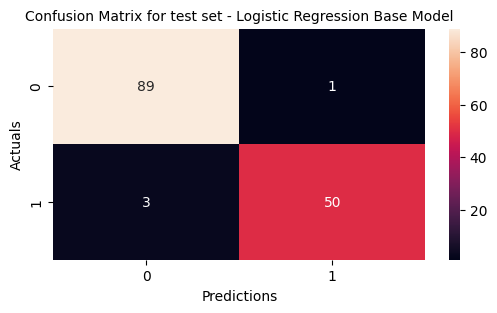

In [104]:
fig, ax = plt.subplots(figsize=(6, 3))

ax = sns.heatmap(con_matrix_lor_base, annot=True, fmt = '.0f')
 
plt.xlabel('Predictions', fontsize=10)
plt.ylabel('Actuals', fontsize=10)
plt.title('Confusion Matrix for test set - Logistic Regression Base Model', fontsize=10)
plt.show()

### Random Forest Model

`Model Fitting on Train Data`

In [105]:
classifier_RF_base = RandomForestClassifier(random_state=42)

In [106]:
model_RF_base = classifier_RF_base.fit(X_train[[i for i in X_train.columns if i in best_features_list]],y_train)
print('Accuracy on train set containing unbalanced data : {:.1f}%'.format(classifier_RF_base.score(X_train[[i for i in X_train.columns if i in best_features_list]], y_train)*100))

Accuracy on train set containing unbalanced data : 100.0%


`Model Performance Check on Validation Set`

In [107]:
kf=StratifiedKFold(n_splits=5)
validation_set_score_RF=cross_val_score(model_RF_base,X_train[[i for i in X_train.columns if i in best_features_list]],y_train,scoring='accuracy',cv=kf)

print("Average Cross Validation accuracy is :{:.1f}%".format(validation_set_score_RF.mean()*100))

Average Cross Validation accuracy is :95.3%


The base model is slightly over-fitted as seen from the validation set compared to the training set, but we can reduce the over-fitting with proper hyper-parametr tuning which we will discuss in the later part

`Predicting on Test Data`

In [108]:
predictions_RF_base = classifier_RF_base.predict(X_test[[i for i in X_test.columns if i in best_features_list]])
# evaluate predictions
accuracy_RF_base = accuracy_score(y_test, predictions_RF_base)
print("Accuracy on test set {:.1f}%".format(accuracy_RF_base * 100))

Accuracy on test set 97.9%


In [109]:
# confusion matrix in sklearn

# actual values
actual_RF_base = y_test.values.tolist()
# predicted values
predicted_RF_base = predictions_RF_base.tolist()

# confusion matrix
con_matrix_RF_base = confusion_matrix(actual_RF_base,predicted_RF_base)
print('Confusion matrix : \n',con_matrix_RF_base)

# outcome values order in sklearn
tn_RF_base, fp_RF_base, fn_RF_base, tp_RF_base  = con_matrix_RF_base.ravel()
print("\nTPR or Sensitivity or Recall is {:.2f}".format(tp_RF_base/(tp_RF_base+fn_RF_base)),\
      "\nPrecision is {:.2f}".format(tp_RF_base/(tp_RF_base+fp_RF_base)), "\nFNR is {:.2f}".format(fn_RF_base/(fn_RF_base+tp_RF_base)),\
      "\nFPR or (1-Specificity) is {:.2f}".format(fp_RF_base/(fp_RF_base+tn_RF_base)),"\nTNR is {:.2f}".format(tn_RF_base/(tn_RF_base+fp_RF_base)),\
      "\nPrecision is {:.2f}".format(tp_RF_base/(tp_RF_base+fp_RF_base)))


# classification report for precision, recall f1-score and accuracy
matrix_RF_base = classification_report(actual_RF_base,predicted_RF_base)
print('\nClassification report : \n',matrix_RF_base)

Confusion matrix : 
 [[90  0]
 [ 3 50]]

TPR or Sensitivity or Recall is 0.94 
Precision is 1.00 
FNR is 0.06 
FPR or (1-Specificity) is 0.00 
TNR is 1.00 
Precision is 1.00

Classification report : 
               precision    recall  f1-score   support

           0       0.97      1.00      0.98        90
           1       1.00      0.94      0.97        53

    accuracy                           0.98       143
   macro avg       0.98      0.97      0.98       143
weighted avg       0.98      0.98      0.98       143



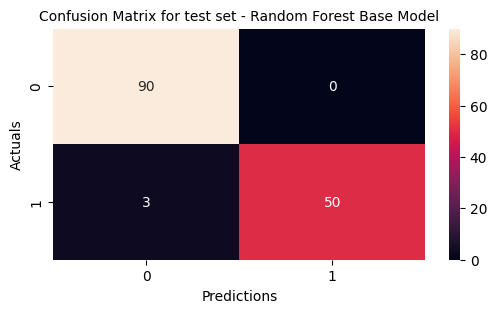

In [110]:
fig, ax = plt.subplots(figsize=(6, 3))

ax = sns.heatmap(con_matrix_RF_base, annot=True, fmt = '.0f')
 
plt.xlabel('Predictions', fontsize=10)
plt.ylabel('Actuals', fontsize=10)
plt.title('Confusion Matrix for test set - Random Forest Base Model', fontsize=10)
plt.show()

 #### XG Boost

`Model Fitting on Train Data`

In [111]:
classifier_xgb_base = xgb.XGBClassifier(random_state=42)

In [112]:
model_xgb_base = classifier_xgb_base.fit(X_train[[i for i in X_train.columns if i in best_features_list]],y_train)
print('Accuracy on train set containing unbalanced data : {:.2f}%'.format(classifier_xgb_base.score(X_train[[i for i in X_train.columns if i in best_features_list]], y_train)*100))

Accuracy on train set containing unbalanced data : 100.00%


`Model Performance Check on Validation Set`

In [113]:
kf=StratifiedKFold(n_splits=5)
validation_set_score_XGB=cross_val_score(model_xgb_base,X_train[[i for i in X_train.columns if i in best_features_list]],y_train,scoring='accuracy',cv=kf)

print("Average Cross Validation accuracy is :{:.1f}%".format(validation_set_score_XGB.mean()*100))

Average Cross Validation accuracy is :95.1%


`Predicting on Test Data`

In [114]:
predictions_XGB_base= classifier_xgb_base.predict(X_test[[i for i in X_test.columns if i in best_features_list]])
# evaluate predictions
accuracy_xgb_base = accuracy_score(y_test, predictions_XGB_base)
print("Accuracy on test set : %.1f%%" % (accuracy_xgb_base * 100.0))

Accuracy on test set : 98.6%


In [115]:
# confusion matrix in sklearn

# actual values
actual_XGB_base = y_test.values.tolist()
# predicted values
predicted_XGB_base = predictions_XGB_base.tolist()

# confusion matrix
con_matrix_XGB_base = confusion_matrix(actual_XGB_base,predicted_XGB_base)
print('Confusion matrix : \n',con_matrix_XGB_base)

# outcome values order in sklearn
tn_XGB_base, fp_XGB_base, fn_XGB_base, tp_XGB_base  = con_matrix_XGB_base.ravel()
print("\nTPR or Sensitivity or Recall is {:.2f}".format(tp_XGB_base/(tp_XGB_base+fn_XGB_base)),\
      "\nPrecision is {:.2f}".format(tp_XGB_base/(tp_XGB_base+fp_XGB_base)), "\nFNR is {:.2f}".format(fn_XGB_base/(fn_XGB_base+tp_XGB_base)),\
      "\nFPR or (1-Specificity) is {:.2f}".format(fp_XGB_base/(fp_XGB_base+tn_XGB_base)),"\nTNR is {:.2f}".format(tn_XGB_base/(tn_XGB_base+fp_XGB_base)),\
      "\nPrecision is {:.2f}".format(tp_XGB_base/(tp_XGB_base+fp_XGB_base)))


# classification report for precision, recall f1-score and accuracy
matrix_XGB_base = classification_report(actual_XGB_base,predicted_XGB_base)
print('\nClassification report : \n',matrix_XGB_base)

Confusion matrix : 
 [[90  0]
 [ 2 51]]

TPR or Sensitivity or Recall is 0.96 
Precision is 1.00 
FNR is 0.04 
FPR or (1-Specificity) is 0.00 
TNR is 1.00 
Precision is 1.00

Classification report : 
               precision    recall  f1-score   support

           0       0.98      1.00      0.99        90
           1       1.00      0.96      0.98        53

    accuracy                           0.99       143
   macro avg       0.99      0.98      0.98       143
weighted avg       0.99      0.99      0.99       143



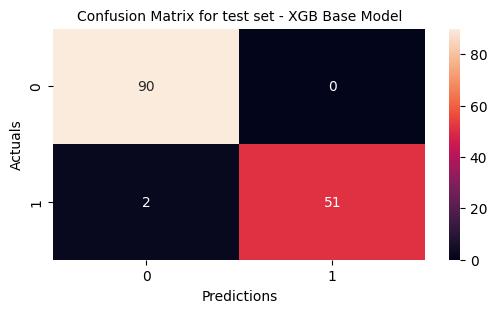

In [116]:
fig, ax = plt.subplots(figsize=(6, 3))

ax = sns.heatmap(con_matrix_XGB_base, annot=True, fmt = '.0f')
 
plt.xlabel('Predictions', fontsize=10)
plt.ylabel('Actuals', fontsize=10)
plt.title('Confusion Matrix for test set - XGB Base Model', fontsize=10)
plt.show()

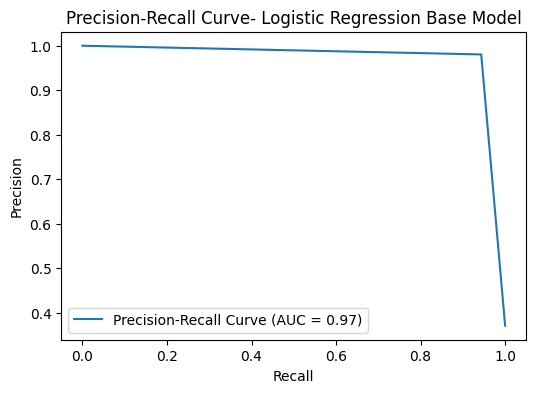

In [117]:
precision_lor_base, recall_lor_base, thresholds = precision_recall_curve(y_test, predictions_lor_base)
auc_score_lor_base = auc(recall_lor_base, precision_lor_base)

plt.figure(figsize=(6, 4))
plt.plot(recall_lor_base, precision_lor_base, label=f'Precision-Recall Curve (AUC = {auc_score_lor_base:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve- Logistic Regression Base Model')
plt.legend()
plt.show()

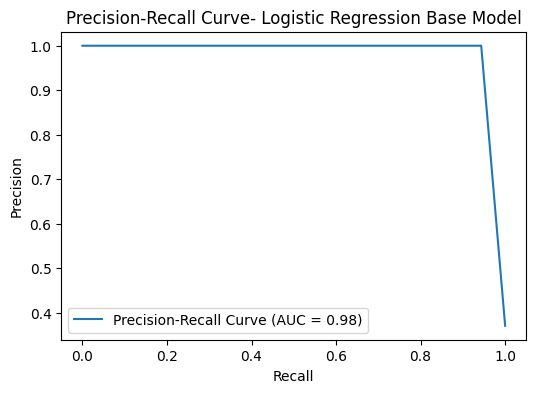

In [118]:
precision_RF_base, recall_RF_base, thresholds = precision_recall_curve(y_test, predictions_RF_base)
auc_score_RF_base = auc(recall_RF_base, precision_RF_base)

plt.figure(figsize=(6, 4))
plt.plot(recall_RF_base, precision_RF_base, label=f'Precision-Recall Curve (AUC = {auc_score_RF_base:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve- Logistic Regression Base Model')
plt.legend()
plt.show()

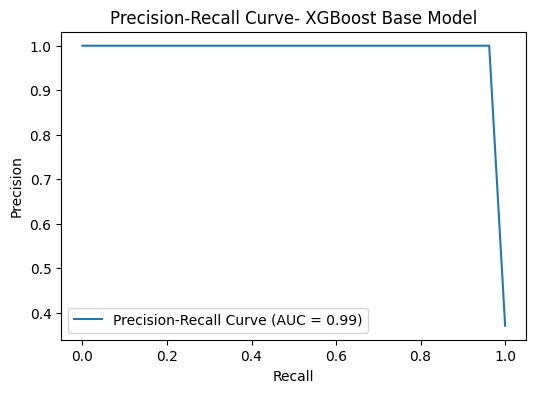

In [119]:
precision_XGB_base, recall_XGB_base, thresholds = precision_recall_curve(y_test, predictions_XGB_base)
auc_score_XGB_base = auc(recall_XGB_base, precision_XGB_base)

plt.figure(figsize=(6, 4))
plt.plot(recall_XGB_base, precision_XGB_base, label=f'Precision-Recall Curve (AUC = {auc_score_XGB_base:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve- XGBoost Base Model')
plt.legend()
plt.show()

In [120]:
XGB_base_metrics = [accuracy_xgb_base,\
                    #tp_XGB_base/ (fp_XGB_base + tp_XGB_base),\
                    fp_XGB_base/ (fp_XGB_base + tn_XGB_base),\
               fn_XGB_base/ (fn_XGB_base + tp_XGB_base),\
              tp_XGB_base/ (tp_XGB_base + fn_XGB_base),\
              tp_XGB_base/ (tp_XGB_base + fp_XGB_base)]

RF_base_metrics = [accuracy_RF_base,\
                   #tp_RF_base/ (fp_RF_base + tp_RF_base),\
                   fp_RF_base/ (fp_RF_base + tn_RF_base), \
              fn_RF_base/ (fn_RF_base + tp_RF_base),\
             tp_RF_base/ (tp_RF_base + fn_RF_base),\
             tp_RF_base/ (tp_RF_base + fp_RF_base)]

lor_base_metrics = [accuracy_lor_base,\
                    #tp_lor_base/ (fp_lor_base + tp_lor_base),\
                    fp_lor_base/ (fp_lor_base + tn_lor_base), \
               fn_lor_base/ (fn_lor_base + tp_lor_base),\
              tp_lor_base/ (tp_lor_base + fn_lor_base),\
              tp_lor_base/ (tp_lor_base + fp_lor_base)]

In [121]:
metrics_base_model_results = pd.concat([pd.DataFrame(lor_base_metrics).rename(columns={0:'Logistic Regression'}), pd.DataFrame(RF_base_metrics).rename(columns={0:'Random Forest'}), pd.DataFrame(XGB_base_metrics).rename(columns={0:'XGBoost'})], axis=1).reset_index()

In [122]:
metrics_base_model_results = metrics_base_model_results.rename(columns={'index':'Measure'})

metrics_base_model_results.loc[0,'Measure'] = 'Accuracy'
metrics_base_model_results.loc[4,'Measure'] = 'Precision'
metrics_base_model_results.loc[1,'Measure'] = 'False Positive Rate'
metrics_base_model_results.loc[2,'Measure'] = 'False Negative Rate'
metrics_base_model_results.loc[3,'Measure'] = 'Recall'

metrics_base_model_results

,Measure,Logistic Regression,Random Forest,XGBoost
0,Accuracy,0.972028,0.979021,0.986014
1,False Positive Rate,0.011111,0.000000,0.000000
2,False Negative Rate,0.056604,0.056604,0.037736
3,Recall,0.943396,0.943396,0.962264
4,Precision,0.980392,1.000000,1.000000


**Comment**

If we look at the base models, the accuracy is the highest for XGBoost Model i.e. 98.6%

With our main goal here to predict tumor as being a malignant one as the highest priority because not being able to identify a tumor as malignant when it is actually malignant will be a risk to the patient's life , we should be focusing on reducing the False negative Rate and choose the one with the least value implying the fact that True Positive Rate or Sensitivity should be the highest  
 
Therefore, the Recall or True Positive Rate should be our concern in this case i.e. out of the tumors which are actually malignant how many of those were able to be predicted as malignant. With a 96% Recall, XGB is the model to move forward with

## Hyper Parameter Tuning for the XGBoost Model

#### Before getting into hyperparameter tuning, we need to understand the concept of GridSearch Cross Validation or as we call it **GridSearchCV** and **RandomizedSearchCV**

The concept is given certain choices of parameter set, it tries out all possible combinations of hyperparameters one by one. The process of search is not purely random as Randomized Search. For each of the parameter set combinations, the model is trained and evaluated on the cross validation set. Instead of just looking at train-test split, this is a much reliable procedure as the model is fitted on multiple subsets of the training data with samples coming from with replacement procedure.

In contrast to GridSearchCV, in RandomizedSearch not all parameter values are tried out, but rather a fixed number of parameter settings is sampled from the specified distributions. The number of parameter settings that are tried is given by n_iter.

## `XG Boost Model Tuned`

#### XGBoost Model HyperParameters :-


1. **max_depth** : Maximum depth of a tree. If we increase this, the model becomes more complex and likely to overfit

2. **min_child_weight** : Minimum sum of instance weight needed in a child. Larger values prevent overfitting. If the tree partition step results in a leaf node with the sum of instance weight less than min_child_weight, then the building process will give up further partitioning. In linear regression mode, this simply corresponds to minimum number of instances needed to be in each node. The larger, the more conservative the algorithm will be.

3. **subsample** : The subsample parameter determines the fraction of observations to be randomly sampled for each tree during the model’s training process. It occurs at every depth of the tree. It is a regularization technique that can help prevent overfitting by introducing randomness into the training data. Subsample accepts values between 0 and 1, with 1 meaning that all observations are used for each tree. The default value of subsample in XGBoost is 1. Lower values prevent overfitting.

4. **colsample_bytree** : It is the fraction of features (randomly selected) that will be used to train each tree. Lower values prevent overfitting
These parameters control the amount of randomness introduced into the model during training. 

5. **eta** : The rate at which the boosting algorithm learns at each iteration. Lower value will indicate slower learning rate, thereby scaling down each tree's contribution in the learning in the ensemble model, thus it prevents over-fitting

#### `Parameter Grid For Hyper Parameter Tuning in XG Boost Model`

In [141]:
#param_grid_XGB =[ {'n_estimators': np.arange(30,100,10),\
#                   'max_depth' : np.arange(3,8,1), \
                      # 'min_child_weight' : [1,2,3,5,10],\
                      # 'subsample' : [0.5, 0.7,0.9,1],\
                      # 'scolsample_bytree' : [0.3, 0.5, 0.9,1],\
                      # 'eta' : np.arange(0.3,0.4,0.01)
                  #}] 

In [262]:
param_grid_XGB =[ {'n_estimators': np.arange(50,150,5),\
                   'max_depth' : [3,4,5,6,7,8], \
                    'min_child_weight' : [1,5,15],\
                    'subsample' : np.linspace(0.01,0.7,100),\
                    'colsample_bytree' :np.linspace(0.01,0.7,100),\
                      'eta' : np.linspace(0.001,0.05,100)}] 

In [263]:
clf_XGB = RandomizedSearchCV(model_xgb_base, param_distributions = param_grid_XGB, cv=5, refit=True, verbose=True, n_jobs=-1) # n_jobs=-1 > all available processors
clf_XGB

RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate...
       0.4630303 , 0.47      , 0.4769697 , 0.48393939, 0.49090909,
       0.49787879, 0.50484848, 0.51181818, 0.51878788, 0.52575758,
       0.53272727, 0.53969697, 0.54666667, 0.55363636, 0.56060606,
       0.56757576, 0.57454545, 0.58151515, 0.58848485, 0.59545455,
       0.60242424, 0.60939394, 0.61636364, 0.62333333, 0.63030303,
       0.63727273, 0.64424242, 0.65121212, 0.65818182, 0.66515152,
       0.67212121, 0.67909091, 0.68606061, 0.6930303 , 0.7       ])}],
                   verbose=True)

In [264]:
best_clf_XGB = clf_XGB.fit(X_train[[i for i in X_train.columns if i in best_features_list]],y_train)
best_clf_XGB 

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           callbacks=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, device=None,
                                           early_stopping_rounds=None,
                                           enable_categorical=False,
                                           eval_metric=None, feature_types=None,
                                           gamma=None, grow_policy=None,
                                           importance_type=None,
                                           interaction_constraints=None,
                                           learning_rate...
       0.4630303 , 0.47      , 0.4769697 , 0.48393939, 0.49090909,
       0.49787879, 0.50484848, 0.51181818, 0.51878788, 0.52575758,
       0.53272727, 0.53969697, 0.54666667, 0.55363636, 0.56060606,
       0.56757576, 0.57454545, 0.58151515, 0.58848485, 0.59545455,
       0.60242424, 0.60939394, 0.61636364, 0.62333333, 0.63030303,
       0.63727273, 0.64424242, 0.65121212, 0.65818182, 0.66515152,
       0.67212121, 0.67909091, 0.68606061, 0.6930303 , 0.7       ])}],
                   verbose=True)

In [265]:
best_clf_XGB.best_params_

{'subsample': np.float64(0.5536363636363636),
 'n_estimators': np.int64(105),
 'min_child_weight': 1,
 'max_depth': 8,
 'eta': np.float64(0.026242424242424244),
 'colsample_bytree': np.float64(0.3515151515151515)}

In [266]:
accuracy_score_test_data_tuned_XGB = best_clf_XGB.score(X_test[[i for i in X_train.columns if i in best_features_list]],y_test)
accuracy_score_test_data_tuned_XGB

0.9790209790209791

#### `Tuned XGBoost Model`

In [267]:
classifier_XGB_tuned= xgb.XGBClassifier(eta= 0.026242424242424244,max_depth= 8,min_child_weight= 1,n_estimators = 105,colsample_bytree= 0.3515151515151515,subsample= 0.5536363636363636, random_state=42)

In [268]:
#classifier_XGB_tuned= xgb.XGBClassifier(eta= 0.8,max_depth= 6,min_child_weight= 1,n_estimators = 65,colsample_bytree= 0.45,subsample= 0.4, random_state=42)

In [269]:
model_XGB_tuned = classifier_XGB_tuned.fit(X_train[[i for i in X_train.columns if i in best_features_list]],y_train)
print('Accuracy on train set containing unbalanced data for the tuned model : {:.2f}%'.format(classifier_XGB_tuned.score(X_train[[i for i in X_train.columns if i in best_features_list]], y_train)*100))

Accuracy on train set containing unbalanced data for the tuned model : 97.89%


#### `Predicting test data using the tuned XGB Model`

In [270]:
predictions_XGB_tuned = model_XGB_tuned.predict(X_test[[i for i in X_test.columns if i in best_features_list]])
# evaluate predictions
accuracy_XGB_tuned = accuracy_score(y_test, predictions_XGB_tuned)
print("Accuracy on test set for the tuned model: %.2f%%" % (accuracy_XGB_tuned * 100.0))

Accuracy on test set for the tuned model: 97.90%


#### `Confusion Matrix of the Tuned XGB Model when treated on the test data`

In [271]:
# confusion matrix in sklearn

# actual values
actual_XGB_tuned = y_test.values.tolist()
# predicted values
predicted_XGB_tuned = predictions_XGB_tuned.tolist()

# confusion matrix
con_matrix_XGB_tuned = confusion_matrix(actual_XGB_tuned,predicted_XGB_tuned)
print('Confusion matrix : \n',con_matrix_XGB_tuned)

# outcome values order in sklearn
tn_XGB_tuned, fp_XGB_tuned, fn_XGB_tuned, tp_XGB_tuned  = con_matrix_XGB_tuned.ravel()
print("\nTPR or Sensitivity or Recall is {:.2f}".format(tp_XGB_tuned/(tp_XGB_tuned+fn_XGB_tuned)),\
      "\nPrecision is {:.2f}".format(tp_XGB_tuned/(tp_XGB_tuned+fp_XGB_tuned)), "\nFNR is {:.2f}".format(fn_XGB_tuned/(fn_XGB_tuned+tp_XGB_tuned)),\
      "\nFPR or (1-Specificity) is {:.2f}".format(fp_XGB_tuned/(fp_XGB_tuned+tn_XGB_tuned)),"\nTNR is {:.2f}".format(tn_XGB_tuned/(tn_XGB_tuned+fp_XGB_tuned)),\
      "\nPrecision is {:.2f}".format(tp_XGB_tuned/(tp_XGB_tuned+fp_XGB_tuned)))


# classification report for precision, recall f1-score and accuracy
matrix_XGB_tuned = classification_report(actual_XGB_tuned,predicted_XGB_tuned)
print('\nClassification report : \n',matrix_XGB_tuned)

Confusion matrix : 
 [[90  0]
 [ 3 50]]

TPR or Sensitivity or Recall is 0.94 
Precision is 1.00 
FNR is 0.06 
FPR or (1-Specificity) is 0.00 
TNR is 1.00 
Precision is 1.00

Classification report : 
               precision    recall  f1-score   support

           0       0.97      1.00      0.98        90
           1       1.00      0.94      0.97        53

    accuracy                           0.98       143
   macro avg       0.98      0.97      0.98       143
weighted avg       0.98      0.98      0.98       143



#### `Comparison of the Confusion Matrix of the XGBoost base model Vs Tuned Model`

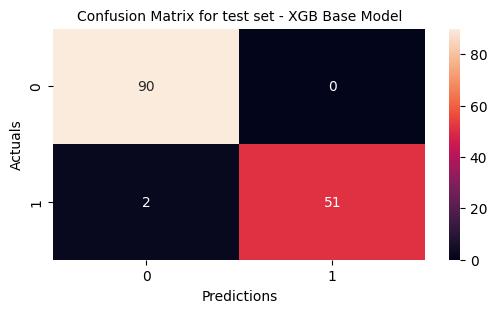

In [272]:
fig, ax = plt.subplots(figsize=(6, 3))

ax = sns.heatmap(con_matrix_XGB_base, annot=True, fmt = '.0f')
 
plt.xlabel('Predictions', fontsize=10)
plt.ylabel('Actuals', fontsize=10)
plt.title('Confusion Matrix for test set - XGB Base Model', fontsize=10)
plt.show()

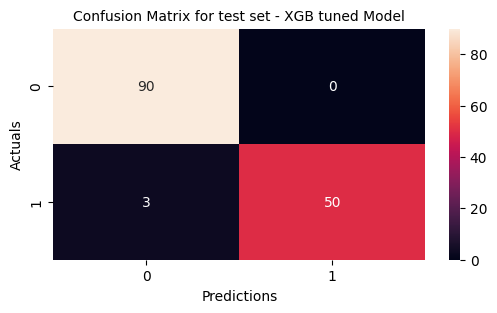

In [273]:
fig, ax = plt.subplots(figsize=(6, 3))

ax = sns.heatmap(con_matrix_XGB_tuned, annot=True, fmt = '.0f')
 
plt.xlabel('Predictions', fontsize=10)
plt.ylabel('Actuals', fontsize=10)
plt.title('Confusion Matrix for test set - XGB tuned Model', fontsize=10)
plt.show()

The roc_auc score is: 0.9716981132075472


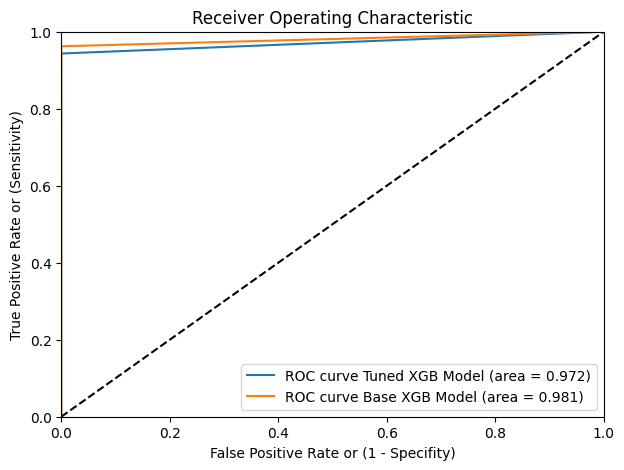

In [274]:
fig, ax = plt.subplots(figsize=(7,5))
# Compute fpr, tpr, thresholds and roc auc

fpr_XGB_tuned, tpr_XGB_tuned, thresholds_tuned = roc_curve(y_test, predicted_XGB_tuned)
roc_auc_XGB_tuned = auc(fpr_XGB_tuned, tpr_XGB_tuned)
gini_coefficient_XGB_tuned = (2*roc_auc_XGB_tuned)-1


fpr_XGB_base, tpr_XGB_base, thresholds_base = roc_curve(y_test, predicted_XGB_base)
roc_auc_XGB_base = auc(fpr_XGB_base, tpr_XGB_base)
gini_coefficient_XGB_base = (2*roc_auc_XGB_base)-1


# Plot ROC curve
plt.plot(fpr_XGB_tuned, tpr_XGB_tuned, label='ROC curve Tuned XGB Model (area = %0.3f)' % roc_auc_XGB_tuned)
plt.plot(fpr_XGB_base, tpr_XGB_base, label='ROC curve Base XGB Model (area = %0.3f)' % roc_auc_XGB_base)
plt.plot([0, 1], [0, 1], 'k--')  # random predictions curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate or (1 - Specifity)')
plt.ylabel('True Positive Rate or (Sensitivity)')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")


print('The roc_auc score is:', roc_auc_XGB_tuned)

In [275]:
(fp_XGB_tuned/ (fp_XGB_tuned + tn_XGB_tuned))

np.float64(0.0)

In [276]:
XGB_base_metrics = [accuracy_xgb_base,\
                    #tp_XGB_base/ (fp_XGB_base + tp_XGB_base),\
                    fp_XGB_base/ (fp_XGB_base + tn_XGB_base),\
               fn_XGB_base/ (fn_XGB_base + tp_XGB_base),\
              tp_XGB_base/ (tp_XGB_base + fn_XGB_base),\
              tp_XGB_base/ (tp_XGB_base + fp_XGB_base)]

XGB_tuned_metrics = [accuracy_XGB_tuned,\
                    #tp_XGB_tuned/ (fp_XGB_tuned + tp_XGB_tuned),\
                    fp_XGB_tuned/ (fp_XGB_tuned + tn_XGB_tuned),\
               fn_XGB_tuned/ (fn_XGB_tuned + tp_XGB_tuned),\
              tp_XGB_tuned/ (tp_XGB_tuned + fn_XGB_tuned),\
              tp_XGB_tuned/ (tp_XGB_tuned + fp_XGB_tuned)]

In [277]:
metrics_base_tuned_model_results = pd.concat([pd.DataFrame(XGB_base_metrics).rename(columns={0:'XGB Base Model'}), pd.DataFrame(XGB_tuned_metrics).rename(columns={0:'XGB Tuned Model'})], axis=1).reset_index()

In [278]:
metrics_base_tuned_model_results = metrics_base_tuned_model_results.rename(columns={'index':'Measure'})

metrics_base_tuned_model_results.loc[0,'Measure'] = 'Accuracy'
metrics_base_tuned_model_results.loc[4,'Measure'] = 'Precision'
metrics_base_tuned_model_results.loc[1,'Measure'] = 'False Positive Rate'
metrics_base_tuned_model_results.loc[2,'Measure'] = 'False Negative Rate'
metrics_base_tuned_model_results.loc[3,'Measure'] = 'Recall'

metrics_base_tuned_model_results

,Measure,XGB Base Model,XGB Tuned Model
0,Accuracy,0.986014,0.979021
1,False Positive Rate,0.000000,0.000000
2,False Negative Rate,0.037736,0.056604
3,Recall,0.962264,0.943396
4,Precision,1.000000,1.000000


In [279]:
#plt.plot(fpr_XGB_base, tpr_XGB_base, label='ROC curve Base XGB Model (area = %0.3f)' % roc_auc_XGB_base)

In [280]:
precision_XGB_tuned, recall_XGB_tuned, thresholds = precision_recall_curve(y_test, predictions_XGB_tuned)
auc_score_XGB_tuned = auc(recall_XGB_tuned, precision_XGB_tuned)

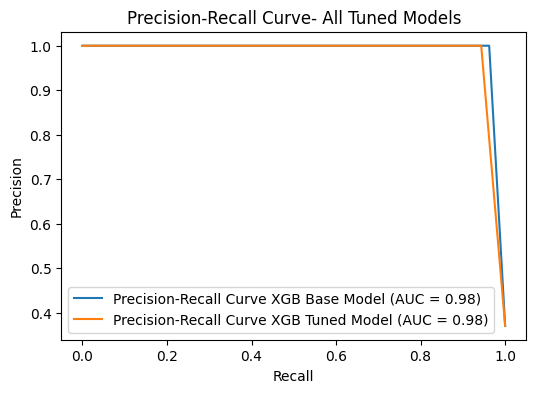

In [281]:
plt.figure(figsize=(6, 4))
#plt.plot(recall_lor_base, precision_lor_tuned, label=f'Precision-Recall Curve LOR Model(AUC = {auc_score_lor_tuned:.2f})')
#plt.plot(recall_RF_base, precision_RF_tuned, label=f'Precision-Recall Curve RF Model (AUC = {auc_score_RF_tuned:.2f})')
plt.plot(recall_XGB_base, precision_XGB_base, label=f'Precision-Recall Curve XGB Base Model (AUC = {auc_score_XGB_tuned:.2f})')
plt.plot(recall_XGB_tuned, precision_XGB_tuned, label=f'Precision-Recall Curve XGB Tuned Model (AUC = {auc_score_XGB_tuned:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve- All Tuned Models')
plt.legend()
plt.show()

<ins> **Comment :** </ins>

We can clearly see that this tuned Random Forest model was able to correctly predict 94% correctly as malignant which are malignant tumors in actual. This is still less than what we have observed in our base model where the Recall was 96%. This we can improve further with more concentration to hyper parameter tuning. 

The main goal here is to detect the Malignant cells correctly i.e. the Recall or True Positive Rate i.e. Percentage of observations correctly identified as "Malignant" when they were really "malignant". In other words our main objective here is to reduce the False Negatives as much as possible because it is risky if a patient was not being treated properly due to mis-identification of the malignant tumor.

Although, the current model is prone to over-fitting , yet the degree of over-fitting has reduced from what it was in the base model.

In [282]:
# import shap

# X_importance_lor = X_test
# explainer_lor = shap.TreeExplainer(classifier_lor_tuned)
# shap_values_lor = explainer.shap_values(X_importance_lor)
# shap.summary_plot(shap_values_lor, X_importance_lor)